In [1]:
#!/usr/bin/env python
# -*- coding: utf-8 -*-

import numpy as np
import pandas as pd
from scipy.spatial import cKDTree

import plotly.graph_objects as go


# =========================
# 0. 路径 & 子盒子范围（改这里）
# =========================
DUMP_PATH = "/ocean/projects/mat250018p/lvlvmei/Shock/scratch/Shock-36903461-0/runs/expoly-1767946930/final.dump"      # 你的 LAMMPS dump 文件


# =========================
# 1. 读 LAMMPS dump → DataFrame
# =========================
def read_lammps_dump_one_timestep(path):
    """
    读取一个 timestep 的 LAMMPS dump：
    ITEM: ATOMS id type x y z grainid quati quatj quatk quatw
    """
    with open(path, "r") as f:
        lines = f.readlines()

    atoms_line_idx = None
    for i, line in enumerate(lines):
        if line.startswith("ITEM: ATOMS"):
            atoms_line_idx = i
            break
    if atoms_line_idx is None:
        raise RuntimeError("没有找到 'ITEM: ATOMS' 行")

    header_tokens = lines[atoms_line_idx].strip().split()
    colnames = header_tokens[2:]

    data_lines = []
    for line in lines[atoms_line_idx + 1:]:
        if line.startswith("ITEM:"):
            break
        if line.strip() == "":
            continue
        data_lines.append(line)

    from io import StringIO
    data_str = "".join(data_lines)
    df = pd.read_csv(StringIO(data_str), delim_whitespace=True, header=None, names=colnames)

    rename_dict = {}
    if "id" in df.columns:
        rename_dict["id"] = "atom-ID"
    if "grainid" in df.columns:
        rename_dict["grainid"] = "grain-ID"
    if "x" in df.columns:
        rename_dict["x"] = "X"
    if "y" in df.columns:
        rename_dict["y"] = "Y"
    if "z" in df.columns:
        rename_dict["z"] = "Z"

    df = df.rename(columns=rename_dict)

    print("[read] 原子数:", len(df))
    print("[read] 列名:", list(df.columns))
    return df


# =========================
# 2. 你的 get_outer_atom
# =========================
def get_outer_atom(DATA, which_grain, to_volume=False, with_outer_ID=False):
    this_grain_boundary = DATA.loc[(DATA['grain-ID'] == which_grain)].index.tolist()
    if len(this_grain_boundary) == 0:
        print("%s disappeared" % (which_grain))
        if with_outer_ID:
            return (pd.DataFrame(), pd.DataFrame(), pd.DataFrame())
        else:
            if to_volume:
                return [], {}, {}
            else:
                return (pd.DataFrame(), pd.DataFrame(), pd.DataFrame(), {})

    data_position = DATA[['X', 'Y', 'Z', "grain-ID", "atom-ID"]].to_numpy()
    tree_pos = cKDTree(data_position[:, [0, 1, 2]])

    surface_index = []
    line_index = []
    point_index = []
    outer_surface_grain = {}
    outer_line_grain = {}
    outer_point_grain = {}
    index_save_grain_ID = {}
    to_volume_nn = []
    index_save_boundary_atom_nn = {}

    for each_atom_index in this_grain_boundary:
        _, idx_pos = tree_pos.query(data_position[each_atom_index, [0, 1, 2]], k=13)
        boundary_atom_pre = data_position[idx_pos, :]

        mask_pos = (boundary_atom_pre[:, 3] != which_grain)
        other_grain_atom = boundary_atom_pre[mask_pos, :]

        if len(other_grain_atom) < 4:
            continue

        atom_to_grain = np.unique(data_position[idx_pos, 3])
        atom_pos_type = len(atom_to_grain)
        outer_atom_to_grain = np.delete(atom_to_grain, np.where(atom_to_grain == which_grain))
        atom_ID = int(data_position[each_atom_index, 4])

        if to_volume:
            to_volume_nn.extend(boundary_atom_pre)
            mask_nn = (boundary_atom_pre[:, 4] != each_atom_index)
            other_grain_atom = boundary_atom_pre[mask_nn, 4]
            index_save_boundary_atom_nn[atom_ID] = other_grain_atom

        if atom_pos_type == 1:
            continue
        elif atom_pos_type == 2:
            surface_index.append(each_atom_index)
            outer_surface_grain[atom_ID] = outer_atom_to_grain.tolist()
        elif atom_pos_type == 3:
            line_index.append(each_atom_index)
            outer_line_grain[atom_ID] = outer_atom_to_grain.tolist()
        elif atom_pos_type == 4:
            point_index.append(each_atom_index)
            outer_point_grain[atom_ID] = outer_atom_to_grain.tolist()
        else:
            continue

    surface_subset = DATA.iloc[surface_index]
    line_subset = DATA.iloc[line_index]
    point_subset = DATA.iloc[point_index]

    if with_outer_ID:
        outer_surface_df = pd.DataFrame.from_dict(outer_surface_grain, orient='index')
        outer_surface_df.reset_index(inplace=True)
        outer_surface_df.columns = ['atom-ID', 'outer1']
        surface_subset = surface_subset.merge(outer_surface_df, on='atom-ID', how='outer')

        outer_line_df = pd.DataFrame.from_dict(outer_line_grain, orient='index')
        outer_line_df.reset_index(inplace=True)
        outer_line_df.columns = ['atom-ID', 'outer1', 'outer2']
        line_subset = line_subset.merge(outer_line_df, on='atom-ID', how='outer')

        outer_point_df = pd.DataFrame.from_dict(outer_point_grain, orient='index')
        outer_point_df.reset_index(inplace=True)
        outer_point_df.columns = ['atom-ID', 'outer1', 'outer2', 'outer3']
        point_subset = point_subset.merge(outer_point_df, on='atom-ID', how='outer')

        return surface_subset, line_subset, point_subset
    else:
        index_save_grain_ID.update(outer_surface_grain)
        index_save_grain_ID.update(outer_line_grain)
        index_save_grain_ID.update(outer_point_grain)
        if not to_volume:
            return surface_subset, line_subset, point_subset, index_save_grain_ID
        else:
            return to_volume_nn, index_save_boundary_atom_nn, index_save_grain_ID


# =========================
# 3. 对所有 grain 分类 surface / line / point
# =========================
from scipy.spatial import cKDTree
import numpy as np
import pandas as pd

def classify_topology_fast(DATA, k=13, min_other_atoms=4):
    """
    一次性对所有原子做 surface / line / point 分类，替代逐 grain 调 get_outer_atom。

    返回：
        surface_all, line_all, point_all  三个 DataFrame
        outer_map: dict[atom-ID] -> list[outer_grain_ids]
    """
    # --- 准备数组 ---
    pos   = DATA[["X", "Y", "Z"]].to_numpy()
    grain = DATA["grain-ID"].to_numpy().astype(int)
    atom_id = DATA["atom-ID"].to_numpy().astype(int)
    N = len(DATA)

    tree = cKDTree(pos)
    # 一次性查所有原子的 k 个邻居
    dists, idx_knn = tree.query(pos, k=k)

    surface_idx = []
    line_idx = []
    point_idx = []

    outer_surface = {}
    outer_line = {}
    outer_point = {}

    for i in range(N):
        neigh_idx = idx_knn[i]
        neigh_grain = grain[neigh_idx]

        # 至少要有 min_other_atoms 个“其他 grain”的原子，才算边界
        mask_other = neigh_grain != grain[i]
        if np.sum(mask_other) < min_other_atoms:
            continue

        unique_grains = np.unique(neigh_grain)
        atom_pos_type = len(unique_grains)

        if atom_pos_type == 1:
            continue  # 完全内部
        # 其它 grain（无序列表）
        outer = unique_grains[unique_grains != grain[i]].tolist()
        a_id = int(atom_id[i])

        if atom_pos_type == 2:
            surface_idx.append(i)
            outer_surface[a_id] = outer
        elif atom_pos_type == 3:
            line_idx.append(i)
            outer_line[a_id] = outer
        elif atom_pos_type == 4:
            point_idx.append(i)
            outer_point[a_id] = outer
        else:
            # >4 个 grain 混在一起：很罕见，先忽略或按需要另处理
            continue

    # --- 切回 DataFrame ---
    surface_all = DATA.iloc[surface_idx].copy()
    line_all    = DATA.iloc[line_idx].copy()
    point_all   = DATA.iloc[point_idx].copy()

    # 加上 outer1/2/3 列（保持和你原来 get_outer_atom+merge 一致）
    if surface_idx:
        surf_outer_df = (pd.DataFrame.from_dict(outer_surface, orient="index")
                         .reset_index()
                         .rename(columns={"index": "atom-ID", 0: "outer1"}))
        surface_all = surface_all.merge(surf_outer_df, on="atom-ID", how="left")

    if line_idx:
        line_outer_df = (pd.DataFrame.from_dict(outer_line, orient="index")
                         .reset_index()
                         .rename(columns={"index": "atom-ID", 0: "outer1", 1: "outer2"}))
        line_all = line_all.merge(line_outer_df, on="atom-ID", how="left")

    if point_idx:
        point_outer_df = (pd.DataFrame.from_dict(outer_point, orient="index")
                          .reset_index()
                          .rename(columns={
                              "index": "atom-ID",
                              0: "outer1",
                              1: "outer2",
                              2: "outer3",
                          }))
        point_all = point_all.merge(point_outer_df, on="atom-ID", how="left")

    outer_map = {}
    outer_map.update(outer_surface)
    outer_map.update(outer_line)
    outer_map.update(outer_point)

    print(f"[fast] surface: {len(surface_all)}, line: {len(line_all)}, point: {len(point_all)}")
    return surface_all, line_all, point_all, outer_map

# =========================
# 4. 取子盒子 & Plotly 3D 可转动可视化
# =========================
def crop_box(df, x_range, y_range, z_range):
    if df is None or len(df) == 0:
        return df
    m = (
        (df["X"] >= x_range[0]) & (df["X"] <= x_range[1]) &
        (df["Y"] >= y_range[0]) & (df["Y"] <= y_range[1]) &
        (df["Z"] >= z_range[0]) & (df["Z"] <= z_range[1])
    )
    return df[m]


def visualize_box_interactive(surface_df, line_df, point_df,
                              x_range, y_range, z_range):
    surf = crop_box(surface_df, x_range, y_range, z_range)
    line = crop_box(line_df, x_range, y_range, z_range)
    point = crop_box(point_df, x_range, y_range, z_range)

    print(f"[plot] box X{x_range} Y{y_range} Z{z_range}")
    print("       surface:", len(surf), " line:", len(line), " point:", len(point))

    traces = []

    if len(surf):
        traces.append(
            go.Scatter3d(
                x=surf["X"], y=surf["Y"], z=surf["Z"],
                mode="markers",
                marker=dict(size=2),
                name="surface (GB)"
            )
        )

    if len(line):
        traces.append(
            go.Scatter3d(
                x=line["X"], y=line["Y"], z=line["Z"],
                mode="markers",
                marker=dict(size=4),
                name="triple line"
            )
        )

    if len(point):
        traces.append(
            go.Scatter3d(
                x=point["X"], y=point["Y"], z=point["Z"],
                mode="markers",
                marker=dict(size=6, symbol="diamond"),
                name="quadruple point"
            )
        )

    layout = go.Layout(
        title="GB surface / triple line / quadruple point (interactive)",
        scene=dict(
            xaxis=dict(title="X", range=list(x_range)),
            yaxis=dict(title="Y", range=list(y_range)),
            zaxis=dict(title="Z", range=list(z_range)),
            aspectmode="data"
        ),
        width=700,
        height=650,
        showlegend=True
    )

    fig = go.Figure(data=traces, layout=layout)
    fig.show()


In [2]:
DATA = read_lammps_dump_one_timestep(DUMP_PATH)

# ===== 1. 计算内外盒子范围（裁掉 0.5% 的壳）=====
crop_ratio = 0.015   # 每一侧裁掉 1.5%，你可以改成 0.01 / 0.02 等

xmin, xmax = DATA["X"].min(), DATA["X"].max()
ymin, ymax = DATA["Y"].min(), DATA["Y"].max()
zmin, zmax = DATA["Z"].min(), DATA["Z"].max()

Lx = xmax - xmin
Ly = ymax - ymin
Lz = zmax - zmin

x_in_min = xmin + crop_ratio * Lx
x_in_max = xmax - crop_ratio * Lx
y_in_min = ymin + crop_ratio * Ly
y_in_max = ymax - crop_ratio * Ly
z_in_min = zmin + crop_ratio * Lz
z_in_max = zmax - crop_ratio * Lz

# “内部块” 的 mask（真正我们关心的区域）
mask_inner = (
    (DATA["X"] >= x_in_min) & (DATA["X"] <= x_in_max) &
    (DATA["Y"] >= y_in_min) & (DATA["Y"] <= y_in_max) &
    (DATA["Z"] >= z_in_min) & (DATA["Z"] <= z_in_max)
)

# “外壳” 的 mask（原来打算丢掉的那一圈）
mask_outer = ~mask_inner

print(f"原始原子数: {len(DATA)}")
print(f"内部块原子数: {mask_inner.sum()}")
print(f"外壳原子数: {mask_outer.sum()}")

# ===== 2. 把外壳按 6 个面分成 6 个 surface-grain =====
DATA_mod = DATA.copy()

grain_max = int(DATA_mod["grain-ID"].max())
G_xmin = grain_max + 1
G_xmax = grain_max + 2
G_ymin = grain_max + 3
G_ymax = grain_max + 4
G_zmin = grain_max + 5
G_zmax = grain_max + 6

print("surface grain-IDs:",
      "G_xmin=", G_xmin,
      "G_xmax=", G_xmax,
      "G_ymin=", G_ymin,
      "G_ymax=", G_ymax,
      "G_zmin=", G_zmin,
      "G_zmax=", G_zmax)

# 只取外壳原子出来做一遍“最近表面”判断
outer = DATA_mod.loc[mask_outer, ["X", "Y", "Z"]].copy()
x = outer["X"].to_numpy()
y = outer["Y"].to_numpy()
z = outer["Z"].to_numpy()

# 到 6 个面的距离
dx_min = x - xmin
dx_max = xmax - x
dy_min = y - ymin
dy_max = ymax - y
dz_min = z - zmin
dz_max = zmax - z

dists = np.vstack([dx_min, dx_max, dy_min, dy_max, dz_min, dz_max]).T  # shape (N_outer, 6)
face_idx = np.argmin(dists, axis=1)   # 每个点最近的是哪个面 (0..5)

# 对应 6 个面的 grain-ID
face_grain_ids = np.array([G_xmin, G_xmax, G_ymin, G_ymax, G_zmin, G_zmax], dtype=int)
assigned_ids = face_grain_ids[face_idx]

# 回写到 DATA_mod["grain-ID"]
DATA_mod.loc[mask_outer, "grain-ID"] = assigned_ids

# ===== 3. 在 DATA_mod 上做一次性拓扑分类 =====
surface_all, line_all, point_all, outer_map = classify_topology_fast(DATA_mod, k=25)

print("surface_all 数量:", len(surface_all))
print("line_all    数量:", len(line_all))
print("point_all   数量:", len(point_all))


/var/tmp/ipykernel_57224/838229102.py:49: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  df = pd.read_csv(StringIO(data_str), delim_whitespace=True, header=None, names=colnames)


[read] 原子数: 20992410
[read] 列名: ['atom-ID', 'type', 'X', 'Y', 'Z', 'grain-ID']
原始原子数: 20992410
内部块原子数: 19217090
外壳原子数: 1775320
surface grain-IDs: G_xmin= 1007 G_xmax= 1008 G_ymin= 1009 G_ymax= 1010 G_zmin= 1011 G_zmax= 1012
[fast] surface: 2188234, line: 375584, point: 27834
surface_all 数量: 2188234
line_all    数量: 375584
point_all   数量: 27834


In [3]:
import plotly.graph_objects as go

# ---------- 1. 构建 quadruple ID 并合并 ----------
def make_quad_id(row):
    gset = sorted([
        int(row["grain-ID"]),
        int(row["outer1"]),
        int(row["outer2"]),
        int(row["outer3"]),
    ])
    return tuple(gset)

point_all = point_all.copy()
if not {"outer1", "outer2", "outer3"}.issubset(point_all.columns):
    raise RuntimeError("point_all 需要包含 outer1/outer2/outer3，请先正确运行 Cell 0")

point_all["quad_id"] = point_all.apply(make_quad_id, axis=1)

# 每个 quad_id 把 X,Y,Z 取平均，合并为一个点
quad_group = (point_all
              .groupby("quad_id", as_index=False)
              .agg({
                  "X": "mean",
                  "Y": "mean",
                  "Z": "mean",
                  "grain-ID": "first",
                  "outer1": "first",
                  "outer2": "first",
                  "outer3": "first",
              }))

quad_unique = quad_group.rename(columns={
    "X": "X_mean",
    "Y": "Y_mean",
    "Z": "Z_mean"
})

print("原始 quadruple points 数量:", len(point_all))
print("合并后唯一 quadruple junction 数量:", len(quad_unique))

# ---------- 2. 计算坐标范围 ----------
all_X = pd.concat([line_all["X"], quad_unique["X_mean"]])
all_Y = pd.concat([line_all["Y"], quad_unique["Y_mean"]])
all_Z = pd.concat([line_all["Z"], quad_unique["Z_mean"]])

x_range = [float(all_X.min()), float(all_X.max())]
y_range = [float(all_Y.min()), float(all_Y.max())]
z_range = [float(all_Z.min()), float(all_Z.max())]

# ---------- 3. Plotly 可旋转 3D 图 ----------
# fig = go.Figure()

# # triple line 全部原子（包括边界）
# fig.add_trace(
#     go.Scatter3d(
#         x=line_all["X"],
#         y=line_all["Y"],
#         z=line_all["Z"],
#         mode="markers",
#         marker=dict(size=2),
#         name="triple line atoms"
#     )
# )

# # 合并后的 quadruple junction
# fig.add_trace(
#     go.Scatter3d(
#         x=quad_unique["X_mean"],
#         y=quad_unique["Y_mean"],
#         z=quad_unique["Z_mean"],
#         mode="markers",
#         marker=dict(size=6, symbol="diamond"),
#         name="quadruple junction (merged)"
#     )
# )

# fig.update_layout(
#     title="Triple lines & merged quadruple junctions",
#     scene=dict(
#         xaxis=dict(title="X", range=x_range),
#         yaxis=dict(title="Y", range=y_range),
#         zaxis=dict(title="Z", range=z_range),
#         aspectmode="data",
#     ),
#     width=800,
#     height=700,
#     showlegend=True,
# )

# fig.show()


原始 quadruple points 数量: 27834
合并后唯一 quadruple junction 数量: 2393


In [4]:
import itertools
import plotly.graph_objects as go
import numpy as np

# ---------- 1. triple line 的 tri_id ----------
def make_tri_id(row):
    gset = sorted([
        int(row["grain-ID"]),
        int(row["outer1"]),
        int(row["outer2"]),
    ])
    return tuple(gset)

line_all = line_all.copy()
if not {"outer1", "outer2"}.issubset(line_all.columns):
    raise RuntimeError("line_all 需要包含 outer1/outer2，请先正确运行 Cell 0")

line_all["tri_id"] = line_all.apply(make_tri_id, axis=1)
tri_unique = line_all["tri_id"].unique()
print("不同 triple-line 3-grain 组合数量:", len(tri_unique))

# ---------- 2. 为 quad_unique 建索引 ----------
quad_unique = quad_unique.copy()
quad_unique["quad_set"] = quad_unique["quad_id"].apply(lambda t: frozenset(t))

quad_sets = list(quad_unique["quad_set"])
quad_positions = quad_unique[["X_mean", "Y_mean", "Z_mean"]].to_numpy()

# ---------- 3. tri_id -> 多个 quadruple junction，构建线段 ----------
segments = []   # 每个元素是 (p1_idx, p2_idx)

for tri in tri_unique:
    tri_set = set(tri)
    incident_quads = []

    # 找到所有包含这个 tri_set 的 quadruple junction
    for qi, qset in enumerate(quad_sets):
        if tri_set.issubset(qset):
            incident_quads.append(qi)

    # 至少连接两个 junction 才画线
    if len(incident_quads) < 2:
        continue

    # 简单：把这些 junction 两两相连
    for i, j in itertools.combinations(incident_quads, 2):
        segments.append((i, j))

print("构建的 quadruple-junction 线段数量:", len(segments))

# ---------- 4. 准备线段坐标 ----------
xs, ys, zs = [], [], []
for i, j in segments:
    x1, y1, z1 = quad_positions[i]
    x2, y2, z2 = quad_positions[j]
    xs.extend([x1, x2, None])
    ys.extend([y1, y2, None])
    zs.extend([z1, z2, None])

# ---------- 5. 画：junction 点 + triple-line skeleton ----------
# fig = go.Figure()

# # triple-line skeleton（连接的线）
# if len(xs) > 0:
#     fig.add_trace(
#         go.Scatter3d(
#             x=xs,
#             y=ys,
#             z=zs,
#             mode="lines",
#             name="triple-line connections"
#         )
#     )

# # junction 节点
# fig.add_trace(
#     go.Scatter3d(
#         x=quad_unique["X_mean"],
#         y=quad_unique["Y_mean"],
#         z=quad_unique["Z_mean"],
#         mode="markers",
#         marker=dict(size=5, symbol="diamond"),
#         name="quadruple junctions"
#     )
# )

# # 淡淡画一层 triple-line 原子当背景
# fig.add_trace(
#     go.Scatter3d(
#         x=line_all["X"],
#         y=line_all["Y"],
#         z=line_all["Z"],
#         mode="markers",
#         marker=dict(size=1),
#         opacity=0.15,
#         name="triple line atoms (bg)"
#     )
# )

# fig.update_layout(
#     title="Quadruple junctions connected via triple-line grain combinations",
#     scene=dict(
#         xaxis=dict(title="X"),
#         yaxis=dict(title="Y"),
#         zaxis=dict(title="Z"),
#         aspectmode="data"
#     ),
#     width=800,
#     height=700,
#     showlegend=True,
# )

# fig.show()


不同 triple-line 3-grain 组合数量: 4164
构建的 quadruple-junction 线段数量: 5532


In [5]:
quad_unique

,quad_id,X_mean,Y_mean,Z_mean,grain-ID,outer1,outer2,outer3,quad_set
0,"(24, 116, 357, 416)",277.359379,256.813850,22.474114,24,116,357,416,"(24, 116, 357, 416)"
1,"(24, 116, 357, 420)",272.903757,281.356757,27.557485,24,116,357,420,"(24, 420, 116, 357)"
2,"(24, 116, 372, 416)",293.427505,249.941235,18.033991,24,116,372,416,"(24, 372, 116, 416)"
3,"(24, 116, 372, 1011)",297.099759,251.045005,13.773827,1011,24,116,372,"(24, 372, 1011, 116)"
4,"(24, 116, 385, 420)",286.711713,311.953745,22.500347,24,116,385,420,"(24, 385, 420, 116)"
...,...,...,...,...,...,...,...,...,...
2388,"(975, 980, 988, 1012)",124.805650,323.571436,943.175881,975,980,988,1012,"(988, 980, 1012, 975)"
2389,"(975, 981, 998, 1012)",220.441317,195.297226,944.467078,975,981,998,1012,"(1012, 981, 998, 975)"
2390,"(976, 984, 1009, 1012)",242.961184,12.414294,944.663206,976,984,1009,1012,"(976, 1009, 1012, 984)"
2391,"(980, 981, 1010, 1012)",237.389101,341.558988,945.623682,1012,980,981,1010,"(1010, 1012, 980, 981)"


In [6]:
import itertools
import numpy as np
import pandas as pd
from sklearn.decomposition import PCA

# ---- 0. 准备 junction 节点数据 ----
quad_unique = quad_unique.copy()
quad_ids = list(quad_unique["quad_id"])   # e.g. (A,B,C,D)
quad_pos = quad_unique[["X_mean", "Y_mean", "Z_mean"]].to_numpy()
n_nodes = len(quad_ids)
print("junction 节点数:", n_nodes)

# ---- 1. tri_id -> 节点索引列表 的映射 ----
tri_to_nodes = {}

for nid, q in enumerate(quad_ids):
    grains = list(q)
    for comb in itertools.combinations(grains, 3):  # 每个 junction 对应 4 选 3 = 4 个 tri
        tri = tuple(sorted(comb))                   # tri 是一个 3-grain tuple
        if tri not in tri_to_nodes:
            tri_to_nodes[tri] = []
        tri_to_nodes[tri].append(nid)

print("不同 triple-line 3-grain 组合数量:", len(tri_to_nodes))

# ---- 2. 对每个 tri，把节点按几何顺序串成一条线 ----
segments = []   # 新的 skeleton

for tri, nodes in tri_to_nodes.items():
    if len(nodes) < 2:
        continue

    pts = quad_pos[nodes]          # shape (m, 3)
    if len(nodes) == 2:
        # 只有两个点，直接连一条边
        segments.append((nodes[0], nodes[1]))
        continue

    # 用 PCA 找主方向（1D），按投影坐标排序
    pca = PCA(n_components=1)
    pca.fit(pts)
    direction = pca.components_[0]            # (3,)
    center = pts.mean(axis=0)
    t = (pts - center) @ direction           # 每个点在主方向上的坐标 (m,)

    order = np.argsort(t)
    ordered_nodes = [nodes[i] for i in order]

    # 按顺序连接： (n0,n1), (n1,n2), ...，保证这条 triple line 连成一串
    for a, b in zip(ordered_nodes[:-1], ordered_nodes[1:]):
        segments.append((a, b))

print("新 skeleton segments 数量:", len(segments))


junction 节点数: 2393
不同 triple-line 3-grain 组合数量: 4570
新 skeleton segments 数量: 5002


In [7]:
segments

[(0, 1),
 (0, 2),
 (0, 6),
 (0, 422),
 (422, 423),
 (1, 4),
 (1, 11),
 (1, 422),
 (2, 3),
 (8, 13),
 (13, 2),
 (2, 424),
 (3, 5),
 (9, 13),
 (13, 3),
 (3, 425),
 (4, 5),
 (4, 14),
 (4, 427),
 (5, 16),
 (5, 428),
 (6, 7),
 (6, 10),
 (10, 8),
 (6, 436),
 (7, 10),
 (10, 9),
 (7, 12),
 (7, 435),
 (8, 9),
 (437, 439),
 (439, 8),
 (438, 439),
 (439, 9),
 (10, 13),
 (10, 439),
 (11, 12),
 (11, 14),
 (11, 489),
 (12, 17),
 (12, 490),
 (13, 439),
 (14, 15),
 (14, 569),
 (15, 16),
 (15, 17),
 (15, 569),
 (16, 17),
 (16, 576),
 (17, 490),
 (18, 19),
 (18, 20),
 (18, 21),
 (18, 462),
 (462, 463),
 (19, 20),
 (19, 21),
 (464, 462),
 (462, 19),
 (20, 21),
 (465, 466),
 (466, 20),
 (20, 462),
 (462, 21),
 (21, 582),
 (22, 23),
 (22, 24),
 (22, 40),
 (22, 49),
 (49, 48),
 (25, 26),
 (26, 23),
 (23, 45),
 (23, 50),
 (24, 25),
 (24, 46),
 (24, 53),
 (25, 47),
 (25, 54),
 (47, 26),
 (26, 45),
 (27, 28),
 (27, 29),
 (27, 32),
 (27, 510),
 (28, 31),
 (28, 33),
 (511, 510),
 (510, 28),
 (29, 30),
 (29, 37),

In [8]:
import itertools
import numpy as np
import pandas as pd
from sklearn.decomposition import PCA
from scipy.spatial import ConvexHull, QhullError
import plotly.graph_objects as go

# ==== 0. junction 节点数据 ====
quad_unique = quad_unique.copy()
quad_ids = list(quad_unique["quad_id"])     # 每个是 (g1,g2,g3,g4)
quad_pos = quad_unique[["X_mean", "Y_mean", "Z_mean"]].to_numpy()
n_nodes = len(quad_ids)

print("junction 节点数:", n_nodes)
print("skeleton 边数:", len(segments))

# ==== 1. 统计所有 grain pair 出现次数，选择要画的 GB 面 ====
pair_counts = {}
for q in quad_ids:
    for g1, g2 in itertools.combinations(q, 2):
        key = tuple(sorted((int(g1), int(g2))))
        pair_counts[key] = pair_counts.get(key, 0) + 1

pair_series = pd.Series(pair_counts).sort_values(ascending=False)
print("总 grain pair 数:", len(pair_series))
print("出现次数最多的前 10 个 pair：")
print(pair_series.head(10))

MAX_PAIRS = 100  # 你可以改 20/50/100
pairs_to_plot = list(pair_series.index[:MAX_PAIRS])
pair_set = set(pairs_to_plot)

# ==== 2. 哪些 junction 节点参与了这些面（只用于画红点） ====
node_on_plotted_pair = np.zeros(n_nodes, dtype=bool)
for idx, q in enumerate(quad_ids):
    grain_set = set(int(g) for g in q)
    for g1, g2 in itertools.combinations(grain_set, 2):
        if tuple(sorted((g1, g2))) in pair_set:
            node_on_plotted_pair[idx] = True
            break

print("参与这些 GB 的 junction 数:", node_on_plotted_pair.sum())

# ==== 3. 开始画图 ====
fig = go.Figure()

# ---- 3.1 triple-line skeleton：画 *所有* 边 ----
xs_skel, ys_skel, zs_skel = [], [], []
for a, b in segments:
    x1, y1, z1 = quad_pos[a]
    x2, y2, z2 = quad_pos[b]
    xs_skel.extend([x1, x2, None])
    ys_skel.extend([y1, y2, None])
    zs_skel.extend([z1, z2, None])

fig.add_trace(
    go.Scatter3d(
        x=xs_skel, y=ys_skel, z=zs_skel,
        mode="lines",
        opacity=0.25,
        name="triple-line skeleton (ALL)"
    )
)

# ---- 3.2 参与这些 GB 的 quadruple junction 点（红点） ----
fig.add_trace(
    go.Scatter3d(
        x=quad_pos[node_on_plotted_pair, 0],
        y=quad_pos[node_on_plotted_pair, 1],
        z=quad_pos[node_on_plotted_pair, 2],
        mode="markers",
        marker=dict(size=4, symbol="diamond"),
        name="quadruple junctions (on plotted GBs)"
    )
)

# ---- 3.3 为每个 grain pair 构造“假 surface”并画 Mesh3d ----
for pair in pairs_to_plot:
    g1, g2 = pair

    node_idx = [idx for idx, q in enumerate(quad_ids)
                if {g1, g2}.issubset(set(q))]
    if len(node_idx) < 3:
        continue

    pts = quad_pos[node_idx]   # (M,3)

    # PCA 拟合平面
    pca = PCA(n_components=3)
    pca.fit(pts)
    center = pts.mean(axis=0)
    v1 = pca.components_[0]
    v2 = pca.components_[1]

    diff = pts - center
    u = diff @ v1
    v = diff @ v2
    uv = np.stack([u, v], axis=1)

    # convex hull 得到 polygon
    try:
        hull = ConvexHull(uv)
    except QhullError:
        print(f"ConvexHull 失败, 跳过 pair {pair}")
        continue

    hull_idx = hull.vertices
    if len(hull_idx) < 3:
        continue

    hull_pts3d = pts[hull_idx]
    H = len(hull_pts3d)

    center_3d = hull_pts3d.mean(axis=0)
    verts = np.vstack([hull_pts3d, center_3d])
    center_idx = H

    tri_i, tri_j, tri_k = [], [], []
    for i in range(H):
        j = (i + 1) % H
        tri_i.append(i)
        tri_j.append(j)
        tri_k.append(center_idx)

    tri_i = np.array(tri_i, dtype=int)
    tri_j = np.array(tri_j, dtype=int)
    tri_k = np.array(tri_k, dtype=int)

    fig.add_trace(
        go.Mesh3d(
            x=verts[:, 0],
            y=verts[:, 1],
            z=verts[:, 2],
            i=tri_i,
            j=tri_j,
            k=tri_k,
            opacity=0.35,
            name=f"GB {pair}",
        )
    )

# ==== 4. 布局 ====
fig.update_layout(
    title=f"Fake GB surfaces + ALL triple lines + quadruple junctions (top {MAX_PAIRS} pairs)",
    scene=dict(
        xaxis=dict(title="X"),
        yaxis=dict(title="Y"),
        zaxis=dict(title="Z"),
        aspectmode="data",
    ),
    width=900,
    height=800,
    showlegend=True,
)

fig.show()


junction 节点数: 2393
skeleton 边数: 5002
总 grain pair 数: 2649
出现次数最多的前 10 个 pair：
1008  1010    23
1007  1010    23
      1009    19
1008  1009    18
654   1009    17
955   984     14
659   1010    14
734   1007    13
773   1010    13
975   1012    13
dtype: int64
参与这些 GB 的 junction 数: 842


junction 节点数: 2510
skeleton 边数: 5295
总 grain pair 数: 2706
出现次数最多的前 10 个 pair：
1007  1010    26
1008  1010    25
1007  1009    20
654   1009    19
1008  1009    19
659   1010    16
764   784     15
538   545     15
545   1008    15
1010  1011    14
dtype: int64

将要绘制的 pair 排名区间: [50, 60] (共 11 个)
示例几对 pair: [(1007, 1011), (876, 1009), (424, 454), (812, 1008), (855, 908)]
参与这些 GB 的 junction 数: 117


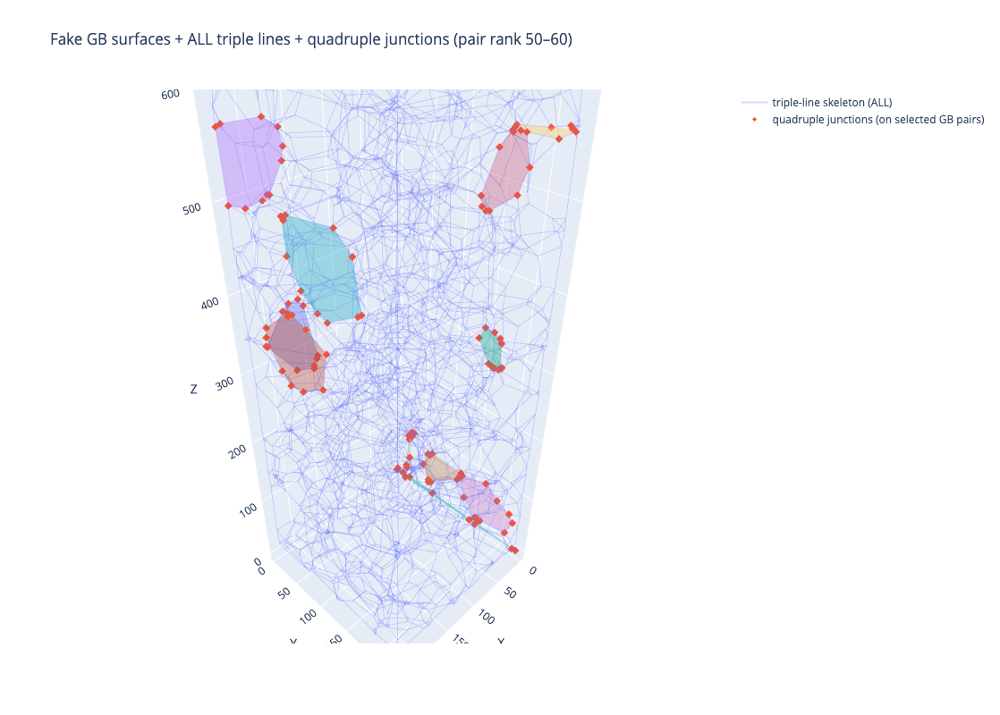

In [8]:
############# 按照pair rank选择GB

import itertools
import numpy as np
import pandas as pd
from sklearn.decomposition import PCA
from scipy.spatial import ConvexHull, QhullError
import plotly.graph_objects as go

# ==== 0. junction 节点数据 ====
quad_unique = quad_unique.copy()
quad_ids = list(quad_unique["quad_id"])     # 每个是 (g1,g2,g3,g4)
quad_pos = quad_unique[["X_mean", "Y_mean", "Z_mean"]].to_numpy()
n_nodes = len(quad_ids)

print("junction 节点数:", n_nodes)
print("skeleton 边数:", len(segments))

# ==== 0.1 配置：选择要画的 grain pair 排名区间 ====
# pair 是按出现次数从高到低排序后的“排名”
PAIR_RANK_START = 50   # 比如：第 50 名（0-based，50 表示“第 51 个”）
PAIR_RANK_END   = 60   # 比如：第 60 名（包含）

# 如果你还是想用“前 N 个”，可以把上面两行改成：
# PAIR_RANK_START = 0
# PAIR_RANK_END   = 149    # 相当于 top 150

# ==== 1. 统计所有 grain pair 出现次数 ====
pair_counts = {}
for q in quad_ids:
    for g1, g2 in itertools.combinations(q, 2):
        key = tuple(sorted((int(g1), int(g2))))
        pair_counts[key] = pair_counts.get(key, 0) + 1

pair_series = pd.Series(pair_counts).sort_values(ascending=False)
print("总 grain pair 数:", len(pair_series))
print("出现次数最多的前 10 个 pair：")
print(pair_series.head(10))

# —— 按排名区间选 pair ——
n_total_pairs = len(pair_series)
i0 = max(0, PAIR_RANK_START)
i1 = min(n_total_pairs, PAIR_RANK_END + 1)   # 右开区间

if i0 >= i1:
    raise ValueError(f"无效区间: PAIR_RANK_START={PAIR_RANK_START}, PAIR_RANK_END={PAIR_RANK_END}")

pairs_to_plot = list(pair_series.index[i0:i1])
pair_set = set(pairs_to_plot)

print(f"\n将要绘制的 pair 排名区间: [{i0}, {i1-1}] (共 {len(pairs_to_plot)} 个)")
print("示例几对 pair:", pairs_to_plot[:5])

# ==== 2. 哪些 junction 节点参与了这些面（只用于画红点） ====
node_on_plotted_pair = np.zeros(n_nodes, dtype=bool)
for idx, q in enumerate(quad_ids):
    grain_set = set(int(g) for g in q)
    for g1, g2 in itertools.combinations(grain_set, 2):
        if tuple(sorted((g1, g2))) in pair_set:
            node_on_plotted_pair[idx] = True
            break

print("参与这些 GB 的 junction 数:", node_on_plotted_pair.sum())

# ==== 2.1 为后面按 pair 做连通分量准备邻接表 ====
# segments 是全局 skeleton 边列表，形如 [(a,b), (c,d), ...]
# 我们先构建一个“无向图”的邻接表，后面在子集上复用。
adj_all = [[] for _ in range(n_nodes)]
for a, b in segments:
    adj_all[a].append(b)
    adj_all[b].append(a)

# ==== 3. 开始画图 ====
fig = go.Figure()

# ---- 3.1 triple-line skeleton：画 *所有* 边 ----
xs_skel, ys_skel, zs_skel = [], [], []
for a, b in segments:
    x1, y1, z1 = quad_pos[a]
    x2, y2, z2 = quad_pos[b]
    xs_skel.extend([x1, x2, None])
    ys_skel.extend([y1, y2, None])
    zs_skel.extend([z1, z2, None])

fig.add_trace(
    go.Scatter3d(
        x=xs_skel, y=ys_skel, z=zs_skel,
        mode="lines",
        opacity=0.25,
        name="triple-line skeleton (ALL)"
    )
)

# ---- 3.2 参与这些 GB 的 quadruple junction 点（红点） ----
fig.add_trace(
    go.Scatter3d(
        x=quad_pos[node_on_plotted_pair, 0],
        y=quad_pos[node_on_plotted_pair, 1],
        z=quad_pos[node_on_plotted_pair, 2],
        mode="markers",
        marker=dict(size=4, symbol="diamond"),
        name="quadruple junctions (on selected GB pairs)"
    )
)

# ==== 3.3 一个小工具：在“包含指定 pair 的节点子集”上找连通分量 ====
def connected_components_on_pair_nodes(node_idx, g1, g2):
    """
    node_idx: list[节点 index]，这些节点的 quad_id 都包含 (g1,g2)
    返回: components = [ [n1,n2,...], [m1,m2,...], ... ]
    """
    node_set = set(node_idx)
    visited = set()
    comps = []

    for start in node_idx:
        if start in visited:
            continue
        stack = [start]
        comp = []
        while stack:
            u = stack.pop()
            if u in visited:
                continue
            visited.add(u)
            comp.append(u)
            # 只沿着 skeleton 上、且仍属于 node_set 的邻接边走
            for v in adj_all[u]:
                if v in node_set and v not in visited:
                    stack.append(v)
        comps.append(comp)
    return comps

# ---- 3.4 为每个 grain pair 构造“假 surface”并画 Mesh3d ----
for pair in pairs_to_plot:
    g1, g2 = pair

    # 先找出所有包含 (g1,g2) 的 junction 节点 index
    node_idx = [idx for idx, q in enumerate(quad_ids)
                if {g1, g2}.issubset(set(int(x) for x in q))]
    if len(node_idx) < 3:
        continue

    # 在这些节点上，根据 skeleton 边找连通分量
    comps = connected_components_on_pair_nodes(node_idx, g1, g2)

    # 丢掉节点数太少的分量；理论上一个 pair 只有一个 GB，保留最大那块
    comps = [c for c in comps if len(c) >= 3]
    if not comps:
        continue

    # 保留最大连通分量，其余删掉（这就是你说的“有多块就融合/删除”的删除版本）
    comps.sort(key=len, reverse=True)
    main_comp = comps[0]
    if len(comps) > 1:
        print(f"[warn] pair {pair} 有多个不相连的 patch, 仅保留最大的一块: {len(main_comp)} nodes, 其余丢弃")

    pts = quad_pos[main_comp]   # (M,3) 这一块 patch 上的 junction 位置

    # PCA 拟合平面
    if pts.shape[0] < 3:
        continue

    pca = PCA(n_components=3)
    pca.fit(pts)
    center = pts.mean(axis=0)
    v1 = pca.components_[0]
    v2 = pca.components_[1]

    # 如果你担心不够平，可以看一下第三主成分的比例：
    # var_ratio = pca.explained_variance_ratio_
    # if var_ratio[2] > 0.1:  # 比如超过 10% 就认为“不够平”，可以选择跳过
    #     print(f"[skip] pair {pair} 不够平 (var_ratio={var_ratio}), 跳过")
    #     continue

    diff = pts - center
    u = diff @ v1
    v = diff @ v2
    uv = np.stack([u, v], axis=1)

    # convex hull 得到 polygon
    try:
        hull = ConvexHull(uv)
    except QhullError:
        print(f"ConvexHull 失败, 跳过 pair {pair}")
        continue

    hull_idx = hull.vertices
    if len(hull_idx) < 3:
        continue

    hull_pts3d = pts[hull_idx]
    H = len(hull_pts3d)

    center_3d = hull_pts3d.mean(axis=0)
    verts = np.vstack([hull_pts3d, center_3d])
    center_idx = H

    tri_i, tri_j, tri_k = [], [], []
    for i in range(H):
        j = (i + 1) % H
        tri_i.append(i)
        tri_j.append(j)
        tri_k.append(center_idx)

    tri_i = np.array(tri_i, dtype=int)
    tri_j = np.array(tri_j, dtype=int)
    tri_k = np.array(tri_k, dtype=int)

    fig.add_trace(
        go.Mesh3d(
            x=verts[:, 0],
            y=verts[:, 1],
            z=verts[:, 2],
            i=tri_i,
            j=tri_j,
            k=tri_k,
            opacity=0.35,
            name=f"GB {pair}",
        )
    )

# ==== 4. 布局 ====
fig.update_layout(
    title=(
        f"Fake GB surfaces + ALL triple lines + quadruple junctions "
        f"(pair rank {PAIR_RANK_START}–{PAIR_RANK_END})"
    ),
    scene=dict(
        xaxis=dict(title="X"),
        yaxis=dict(title="Y"),
        zaxis=dict(title="Z"),
        aspectmode="data",
    ),
    width=900,
    height=800,
    showlegend=True,
)

fig.show()


junction 节点数: 2393
skeleton 边数: 5002
总 grain pair 数: 2649
出现次数最多的前 10 个 pair：
1008  1010    23
1007  1010    23
      1009    19
1008  1009    18
654   1009    17
955   984     14
659   1010    14
734   1007    13
773   1010    13
975   1012    13
dtype: int64

[info] 仅保留包含 grain 27 的 pair, 共 14 个
[info] 与该 grain 相邻的 GB 列表（按三/四重点计数排序，前 20 行）：
 gid1  gid2  n_quads
   27  1007       10
   27   428        8
   27   424        6
   27   427        6
   27   475        6
   27   403        5
   27   369        5
   27   370        5
   27   366        5
   27   459        5
   27    28        5
   27   368        4
   27   396        4
   27   454        4

将要绘制的 pair 数: 14
  - 只限包含 grain 27 的 pair
  - 排名区间: [0, 13] (在过滤后的列表中)
  - 示例几对 pair: [(27, 1007), (27, 428), (27, 424), (27, 427), (27, 475)]
参与这些 GB 的 junction 数: 26


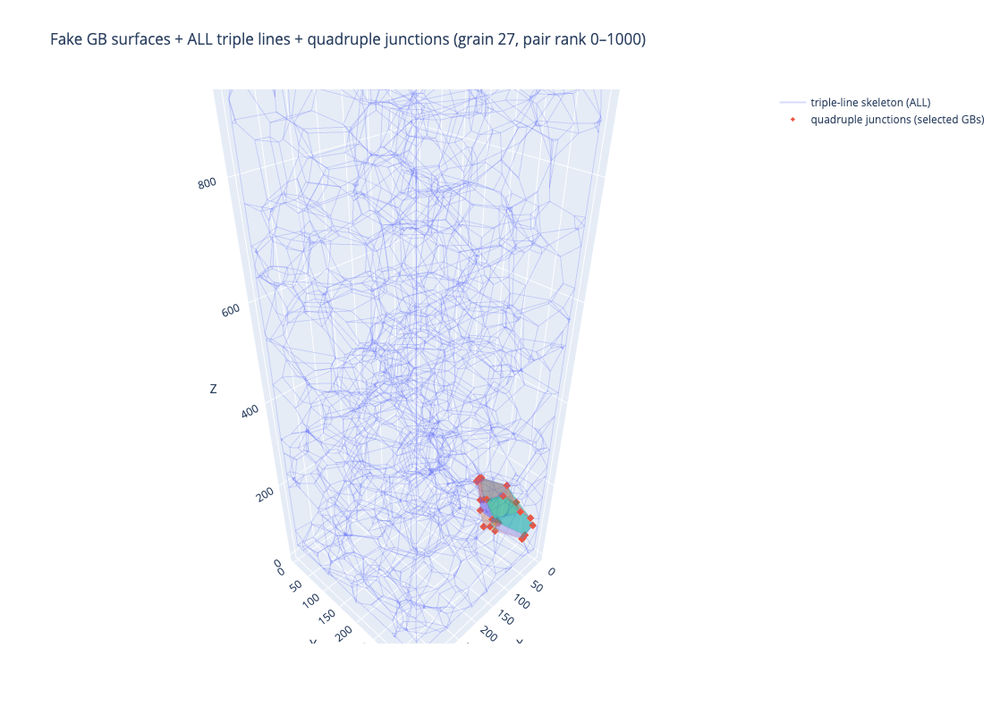

In [9]:
import itertools
import numpy as np
import pandas as pd
from sklearn.decomposition import PCA
from scipy.spatial import ConvexHull, QhullError
import plotly.graph_objects as go

# ==== 0. junction 节点数据 ====
quad_unique = quad_unique.copy()
quad_ids = list(quad_unique["quad_id"])     # 每个是 (g1,g2,g3,g4)
quad_pos = quad_unique[["X_mean", "Y_mean", "Z_mean"]].to_numpy()
n_nodes = len(quad_ids)

print("junction 节点数:", n_nodes)
print("skeleton 边数:", len(segments))

# ==== 0.1 配置 ====
# 1) pair 排名区间（在过滤 grain 后仍然生效）
PAIR_RANK_START = 0       # 比如 0
PAIR_RANK_END   = 1000     # 比如 200，表示最多取 0–200 这段

# 2) 指定一个 grain，只画所有和它相邻的 surface；
#    如果不想按 grain 过滤，就把它设为 None
TARGET_GID = 27         # 比如 123；或者 None 表示不按 grain 过滤

# ==== 1. 统计所有 grain pair 出现次数 ====
pair_counts = {}
for q in quad_ids:
    for g1, g2 in itertools.combinations(q, 2):
        key = tuple(sorted((int(g1), int(g2))))
        pair_counts[key] = pair_counts.get(key, 0) + 1

pair_series = pd.Series(pair_counts).sort_values(ascending=False)
print("总 grain pair 数:", len(pair_series))
print("出现次数最多的前 10 个 pair：")
print(pair_series.head(10))

# ---- 1.1 把 Series 的 index 取出来变成 list[tuple] ----
pairs_sorted_all = list(pair_series.index)  # [(g1,g2), (g3,g4), ...]

# ---- 1.2 如果指定了 TARGET_GID，则只保留包含该 grain 的所有 pair ----
if TARGET_GID is not None:
    tgt = int(TARGET_GID)
    pairs_filtered = [p for p in pairs_sorted_all if tgt in p]
    print(f"\n[info] 仅保留包含 grain {tgt} 的 pair, 共 {len(pairs_filtered)} 个")
    # 为方便查看，给你一个小表
    sub_counts = [pair_series[p] for p in pairs_filtered]
    df_sub = pd.DataFrame({
        "gid1": [p[0] for p in pairs_filtered],
        "gid2": [p[1] for p in pairs_filtered],
        "n_quads": sub_counts
    }).sort_values("n_quads", ascending=False)
    print("[info] 与该 grain 相邻的 GB 列表（按三/四重点计数排序，前 20 行）：")
    print(df_sub.head(20).to_string(index=False))
else:
    pairs_filtered = pairs_sorted_all

# ---- 1.3 在过滤后的列表上再做排名区间截取 ----
n_filtered = len(pairs_filtered)
i0 = max(0, PAIR_RANK_START)
i1 = min(n_filtered, PAIR_RANK_END + 1)   # 右开区间

if i0 >= i1:
    raise ValueError(
        f"无效区间: PAIR_RANK_START={PAIR_RANK_START}, "
        f"PAIR_RANK_END={PAIR_RANK_END}, "
        f"在过滤后仅剩 {n_filtered} 对 pair"
    )

pairs_to_plot = pairs_filtered[i0:i1]
pair_set = set(pairs_to_plot)

print(f"\n将要绘制的 pair 数: {len(pairs_to_plot)}")
if TARGET_GID is not None:
    print(f"  - 只限包含 grain {TARGET_GID} 的 pair")
print(f"  - 排名区间: [{i0}, {i1-1}] (在过滤后的列表中)")
print("  - 示例几对 pair:", pairs_to_plot[:5])

# ==== 2. 哪些 junction 节点参与了这些面（只用于画红点） ====
node_on_plotted_pair = np.zeros(n_nodes, dtype=bool)
for idx, q in enumerate(quad_ids):
    grain_set = set(int(g) for g in q)
    for g1, g2 in itertools.combinations(grain_set, 2):
        if tuple(sorted((g1, g2))) in pair_set:
            node_on_plotted_pair[idx] = True
            break

print("参与这些 GB 的 junction 数:", node_on_plotted_pair.sum())

# ==== 2.1 邻接表（segments -> graph） ====
adj_all = [[] for _ in range(n_nodes)]
for a, b in segments:
    adj_all[a].append(b)
    adj_all[b].append(a)

# ==== 3. 开始画图 ====
fig = go.Figure()

# ---- 3.1 triple-line skeleton：画 *所有* 边 ----
xs_skel, ys_skel, zs_skel = [], [], []
for a, b in segments:
    x1, y1, z1 = quad_pos[a]
    x2, y2, z2 = quad_pos[b]
    xs_skel.extend([x1, x2, None])
    ys_skel.extend([y1, y2, None])
    zs_skel.extend([z1, z2, None])

fig.add_trace(
    go.Scatter3d(
        x=xs_skel, y=ys_skel, z=zs_skel,
        mode="lines",
        opacity=0.25,
        name="triple-line skeleton (ALL)"
    )
)

# ---- 3.2 参与这些 GB 的 quadruple junction 点（红点） ----
fig.add_trace(
    go.Scatter3d(
        x=quad_pos[node_on_plotted_pair, 0],
        y=quad_pos[node_on_plotted_pair, 1],
        z=quad_pos[node_on_plotted_pair, 2],
        mode="markers",
        marker=dict(size=4, symbol="diamond"),
        name="quadruple junctions (selected GBs)"
    )
)

# ==== 3.3 在 pair 的节点子集上找连通分量 ====
def connected_components_on_pair_nodes(node_idx):
    node_set = set(node_idx)
    visited = set()
    comps = []

    for start in node_idx:
        if start in visited:
            continue
        stack = [start]
        comp = []
        while stack:
            u = stack.pop()
            if u in visited:
                continue
            visited.add(u)
            comp.append(u)
            for v in adj_all[u]:
                if v in node_set and v not in visited:
                    stack.append(v)
        comps.append(comp)
    return comps

# ---- 3.4 为每个 grain pair 构造“假 surface”并画 Mesh3d ----
for pair in pairs_to_plot:
    g1, g2 = pair

    # 所有包含 (g1,g2) 的 junction
    node_idx = [idx for idx, q in enumerate(quad_ids)
                if {g1, g2}.issubset(set(int(x) for x in q))]
    if len(node_idx) < 3:
        continue

    # 连通分量
    comps = connected_components_on_pair_nodes(node_idx)
    comps = [c for c in comps if len(c) >= 3]
    if not comps:
        continue

    comps.sort(key=len, reverse=True)
    main_comp = comps[0]
    if len(comps) > 1:
        print(f"[warn] pair {pair} 有多个 patch, 仅保留最大的一块: {len(main_comp)} nodes")

    pts = quad_pos[main_comp]   # (M,3)
    if pts.shape[0] < 3:
        continue

    # PCA 拟合平面
    pca = PCA(n_components=3)
    pca.fit(pts)
    center = pts.mean(axis=0)
    v1 = pca.components_[0]
    v2 = pca.components_[1]

    diff = pts - center
    u = diff @ v1
    v = diff @ v2
    uv = np.stack([u, v], axis=1)

    # convex hull -> polygon
    try:
        hull = ConvexHull(uv)
    except QhullError:
        print(f"ConvexHull 失败, 跳过 pair {pair}")
        continue

    hull_idx = hull.vertices
    if len(hull_idx) < 3:
        continue

    hull_pts3d = pts[hull_idx]
    H = len(hull_pts3d)

    center_3d = hull_pts3d.mean(axis=0)
    verts = np.vstack([hull_pts3d, center_3d])
    center_idx = H

    tri_i, tri_j, tri_k = [], [], []
    for i in range(H):
        j = (i + 1) % H
        tri_i.append(i)
        tri_j.append(j)
        tri_k.append(center_idx)

    tri_i = np.array(tri_i, dtype=int)
    tri_j = np.array(tri_j, dtype=int)
    tri_k = np.array(tri_k, dtype=int)

    fig.add_trace(
        go.Mesh3d(
            x=verts[:, 0],
            y=verts[:, 1],
            z=verts[:, 2],
            i=tri_i,
            j=tri_j,
            k=tri_k,
            opacity=0.35,
            name=f"GB {pair}",
        )
    )

# ==== 4. 布局 ====
if TARGET_GID is None:
    title_suffix = f"pair rank {PAIR_RANK_START}–{PAIR_RANK_END}"
else:
    title_suffix = f"grain {TARGET_GID}, pair rank {PAIR_RANK_START}–{PAIR_RANK_END}"

fig.update_layout(
    title=f"Fake GB surfaces + ALL triple lines + quadruple junctions ({title_suffix})",
    scene=dict(
        xaxis=dict(title="X"),
        yaxis=dict(title="Y"),
        zaxis=dict(title="Z"),
        aspectmode="data",
    ),
    width=900,
    height=800,
    showlegend=True,
)

fig.show()


junction 节点数: 2393
skeleton 边数: 5002
总 grain pair 数: 2649
出现次数最多的前 10 个 pair：
1008  1010    23
1007  1010    23
      1009    19
1008  1009    18
654   1009    17
955   984     14
659   1010    14
734   1007    13
773   1010    13
975   1012    13
dtype: int64

将要绘制的 pair 数: 2649
  - 排名区间: [0, 2648] (在过滤后的列表中)
  - 示例几对 pair: [(1008, 1010), (1007, 1010), (1007, 1009), (1008, 1009), (654, 1009)]
参与这些 GB 的 junction 数: 2393

总共成功三角化的 pair 数: 2531


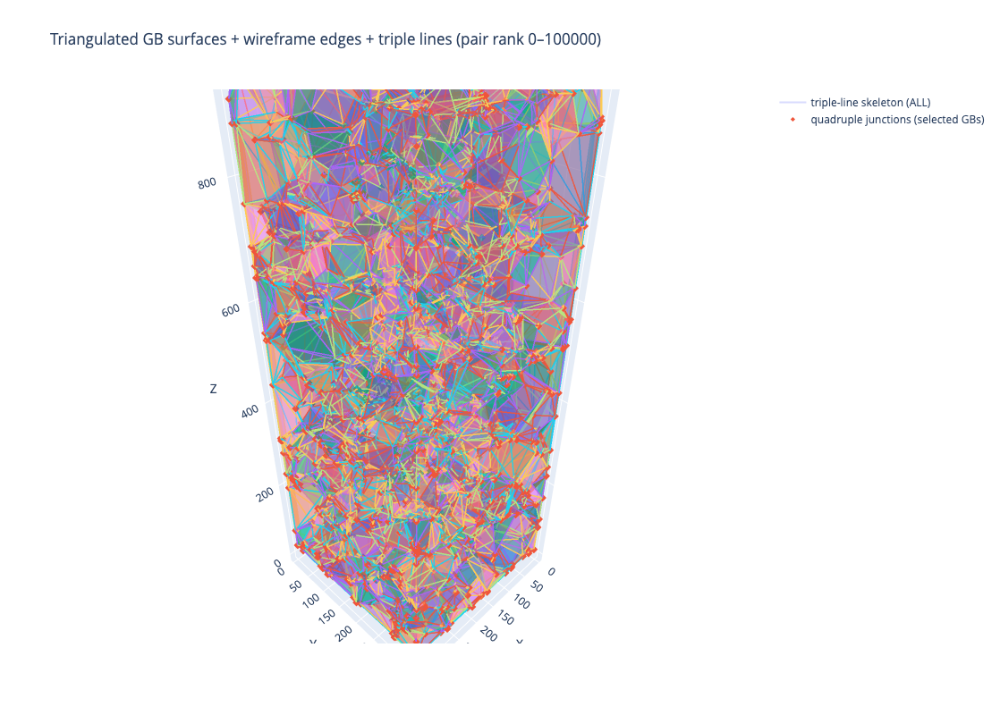

In [10]:
import itertools
import numpy as np
import pandas as pd
from sklearn.decomposition import PCA
from scipy.spatial import Delaunay
import plotly.graph_objects as go

# ==== 0. junction 节点数据（保持你原来的接口）====
quad_unique = quad_unique.copy()
quad_ids = list(quad_unique["quad_id"])     # 每个是 (g1,g2,g3,g4)
quad_pos = quad_unique[["X_mean", "Y_mean", "Z_mean"]].to_numpy()
n_nodes = len(quad_ids)

print("junction 节点数:", n_nodes)
print("skeleton 边数:", len(segments))

# ==== 0.1 配置 ====
PAIR_RANK_START = 0        # 排名区间起点
PAIR_RANK_END   = 100000     # 排名区间终点（含）

# 指定某个 grain，只画与它相邻的所有 GB；None 表示不过滤
TARGET_GID = None

# ==== 1. 统计所有 grain pair 出现次数 ====
pair_counts = {}
for q in quad_ids:
    for g1, g2 in itertools.combinations(q, 2):
        key = tuple(sorted((int(g1), int(g2))))
        pair_counts[key] = pair_counts.get(key, 0) + 1

pair_series = pd.Series(pair_counts).sort_values(ascending=False)
print("总 grain pair 数:", len(pair_series))
print("出现次数最多的前 10 个 pair：")
print(pair_series.head(10))

pairs_sorted_all = list(pair_series.index)  # [(g1,g2), ...]

# ---- 1.2 如果指定了 TARGET_GID，则只保留包含该 grain 的所有 pair ----
if TARGET_GID is not None:
    tgt = int(TARGET_GID)
    pairs_filtered = [p for p in pairs_sorted_all if tgt in p]
    print(f"\n[info] 仅保留包含 grain {tgt} 的 pair, 共 {len(pairs_filtered)} 个")
    sub_counts = [pair_series[p] for p in pairs_filtered]
    df_sub = pd.DataFrame({
        "gid1": [p[0] for p in pairs_filtered],
        "gid2": [p[1] for p in pairs_filtered],
        "n_quads": sub_counts
    }).sort_values("n_quads", ascending=False)
    print("[info] 与该 grain 相邻的 GB 列表（按三/四重点计数排序，前 20 行）：")
    print(df_sub.head(20).to_string(index=False))
else:
    pairs_filtered = pairs_sorted_all

# ---- 1.3 排名区间截取 ----
n_filtered = len(pairs_filtered)
i0 = max(0, PAIR_RANK_START)
i1 = min(n_filtered, PAIR_RANK_END + 1)   # 右开

if i0 >= i1:
    raise ValueError(
        f"无效区间: PAIR_RANK_START={PAIR_RANK_START}, "
        f"PAIR_RANK_END={PAIR_RANK_END}, "
        f"在过滤后仅剩 {n_filtered} 对 pair"
    )

pairs_to_plot = pairs_filtered[i0:i1]
pair_set_to_plot = set(pairs_to_plot)

print(f"\n将要绘制的 pair 数: {len(pairs_to_plot)}")
if TARGET_GID is not None:
    print(f"  - 只限包含 grain {TARGET_GID} 的 pair")
print(f"  - 排名区间: [{i0}, {i1-1}] (在过滤后的列表中)")
print("  - 示例几对 pair:", pairs_to_plot[:5])

# ==== 2. 哪些 junction 节点参与了这些面（为了画红点） ====
node_on_plotted_pair = np.zeros(n_nodes, dtype=bool)
for idx, q in enumerate(quad_ids):
    grain_set = set(int(g) for g in q)
    for g1, g2 in itertools.combinations(grain_set, 2):
        if tuple(sorted((g1, g2))) in pair_set_to_plot:
            node_on_plotted_pair[idx] = True
            break

print("参与这些 GB 的 junction 数:", node_on_plotted_pair.sum())

# ==== 2.1 邻接表（segments -> graph） ====
adj_all = [[] for _ in range(n_nodes)]
for a, b in segments:
    adj_all[a].append(b)
    adj_all[b].append(a)

def connected_components_on_pair_nodes(node_idx):
    """仅在 node_idx 子集上做连通分量，用于分割不同 patch。"""
    node_set = set(node_idx)
    visited = set()
    comps = []

    for start in node_idx:
        if start in visited:
            continue
        stack = [start]
        comp = []
        while stack:
            u = stack.pop()
            if u in visited:
                continue
            visited.add(u)
            comp.append(u)
            for v in adj_all[u]:
                if v in node_set and v not in visited:
                    stack.append(v)
        comps.append(comp)
    return comps

# ==== 3. 先对“整体结构”做三角化，缓存结果 ====

pair_to_mesh = {}   # pair -> list of patch dicts

for pair in pairs_sorted_all:
    g1, g2 = pair

    # 所有包含 (g1,g2) 的 junction index
    node_idx = [idx for idx, q in enumerate(quad_ids)
                if {g1, g2}.issubset(set(int(x) for x in q))]
    if len(node_idx) < 3:
        continue

    comps = connected_components_on_pair_nodes(node_idx)
    comps = [c for c in comps if len(c) >= 3]
    if not comps:
        continue

    comps.sort(key=len, reverse=True)
    pair_patches = []

    for comp in comps[0:1]:   # 目前只保留最大的一块
        pts = quad_pos[comp]   # (M,3)
        if pts.shape[0] < 3:
            continue

        # ---- PCA 拟合局部平面，并投影到 2D ----
        pca = PCA(n_components=3)
        pca.fit(pts)
        center = pca.mean_
        basis = pca.components_  # 3×3

        pts_centered = pts - center
        pts_uv = pts_centered @ basis[:2].T   # (M,2)

        # ---- 在 2D 中做 Delaunay 三角剖分 ----
        try:
            tri = Delaunay(pts_uv)
        except Exception as e:
            print(f"[warn] Delaunay 失败, pair {pair}, 跳过当前 patch, error={e}")
            continue

        simplices = tri.simplices  # (T,3) 三角形顶点索引（局部）
        if simplices.shape[0] == 0:
            continue

        tri_i = simplices[:, 0]
        tri_j = simplices[:, 1]
        tri_k = simplices[:, 2]

        verts = pts  # (M,3)

        patch = {
            "verts": verts,
            "i": tri_i,
            "j": tri_j,
            "k": tri_k,
            "simplices": simplices,
            "node_indices": comp,
        }
        pair_patches.append(patch)

    if pair_patches:
        pair_to_mesh[pair] = pair_patches

print(f"\n总共成功三角化的 pair 数: {len(pair_to_mesh)}")

# ==== 4. 画图 ====

fig = go.Figure()

# ---- 4.1 triple-line skeleton：所有边（淡色线）----
xs_skel, ys_skel, zs_skel = [], [], []
for a, b in segments:
    x1, y1, z1 = quad_pos[a]
    x2, y2, z2 = quad_pos[b]
    xs_skel.extend([x1, x2, None])
    ys_skel.extend([y1, y2, None])
    zs_skel.extend([z1, z2, None])

fig.add_trace(
    go.Scatter3d(
        x=xs_skel, y=ys_skel, z=zs_skel,
        mode="lines",
        opacity=0.25,
        line=dict(width=2),
        name="triple-line skeleton (ALL)",
    )
)

# ---- 4.2 quadruple junction 点（红色 diamond）----
fig.add_trace(
    go.Scatter3d(
        x=quad_pos[node_on_plotted_pair, 0],
        y=quad_pos[node_on_plotted_pair, 1],
        z=quad_pos[node_on_plotted_pair, 2],
        mode="markers",
        marker=dict(size=4, symbol="diamond"),
        name="quadruple junctions (selected GBs)"
    )
)

# ---- 4.3 按 grain / pair 显示已三角化的 GB 面 + 它们的边界线框 ----
for pair in pairs_to_plot:
    if pair not in pair_to_mesh:
        continue

    patches = pair_to_mesh[pair]
    for p_idx, patch in enumerate(patches):
        verts = patch["verts"]
        tri_i = patch["i"]
        tri_j = patch["j"]
        tri_k = patch["k"]
        simplices = patch["simplices"]

        # 4.3.1 先画带填充的 Mesh3d
        fig.add_trace(
            go.Mesh3d(
                x=verts[:, 0],
                y=verts[:, 1],
                z=verts[:, 2],
                i=tri_i,
                j=tri_j,
                k=tri_k,
                opacity=0.45,
                flatshading=True,
                name=f"GB {pair} (patch {p_idx})",
                showscale=False,
            )
        )

        # 4.3.2 再画该 patch 的三角边界（wireframe）
        edges = set()
        for a, b, c in simplices:
            for u, v in [(a, b), (b, c), (c, a)]:
                u, v = int(u), int(v)
                if u == v:
                    continue
                if u > v:
                    u, v = v, u
                edges.add((u, v))

        xs_edge, ys_edge, zs_edge = [], [], []
        for u, v in edges:
            p1 = verts[u]
            p2 = verts[v]
            xs_edge.extend([p1[0], p2[0], None])
            ys_edge.extend([p1[1], p2[1], None])
            zs_edge.extend([p1[2], p2[2], None])

        fig.add_trace(
            go.Scatter3d(
                x=xs_edge,
                y=ys_edge,
                z=zs_edge,
                mode="lines",
                line=dict(width=3),   # 线稍微粗一点，方便看
                opacity=0.9,
                name=f"GB {pair} edges (patch {p_idx})",
                showlegend=False,     # 如果想在图例里出现，可以改成 True
            )
        )

# ==== 5. 布局 ====
if TARGET_GID is None:
    title_suffix = f"pair rank {PAIR_RANK_START}–{PAIR_RANK_END}"
else:
    title_suffix = f"grain {TARGET_GID}, pair rank {PAIR_RANK_START}–{PAIR_RANK_END}"

fig.update_layout(
    title=f"Triangulated GB surfaces + wireframe edges + triple lines ({title_suffix})",
    scene=dict(
        xaxis=dict(title="X"),
        yaxis=dict(title="Y"),
        zaxis=dict(title="Z"),
        aspectmode="data",
    ),
    width=900,
    height=800,
    showlegend=True,
)

fig.show()


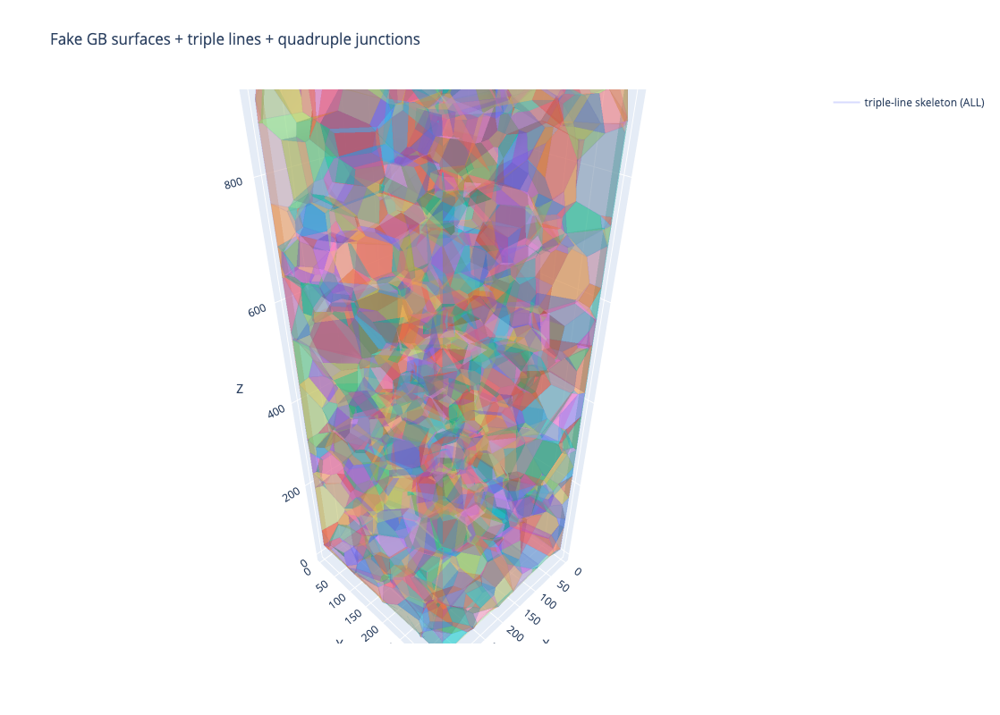

pair_to_mesh 构建完成，总 pair 数: 2531


In [11]:
#### 生成mesh

from sklearn.decomposition import PCA
from scipy.spatial import ConvexHull, QhullError
import numpy as np
import plotly.graph_objects as go

fig = go.Figure()

# ---- 先画 triple-line skeleton 和 quadruple 节点（和你之前的一样）----
# （如果已经画过，可以略过这块）
xs_skel, ys_skel, zs_skel = [], [], []
for a, b in segments:
    x1, y1, z1 = quad_pos[a]
    x2, y2, z2 = quad_pos[b]
    xs_skel.extend([x1, x2, None])
    ys_skel.extend([y1, y2, None])
    zs_skel.extend([z1, z2, None])

fig.add_trace(
    go.Scatter3d(
        x=xs_skel, y=ys_skel, z=zs_skel,
        mode="lines",
        opacity=0.25,
        name="triple-line skeleton (ALL)",
    )
)

# ======= 关键：准备一个 dict 来收集所有三角化的 surface =======
# 结构：pair_to_mesh[(g1,g2)] = [ { "verts": (Nv,3), "simplices": (Nt,3), ... }, ... ]
pair_to_mesh = {}

# ---- 为每个 grain pair 构造“假 surface”，同时填充 pair_to_mesh ----
for pair in pairs_to_plot:
    g1, g2 = pair

    # 找所有包含 (g1,g2) 的 junction 节点
    node_idx = [
        idx for idx, q in enumerate(quad_ids)
        if {g1, g2}.issubset(set(int(x) for x in q))
    ]
    if len(node_idx) < 3:
        continue

    # 连通分量
    comps = connected_components_on_pair_nodes(node_idx)
    comps = [c for c in comps if len(c) >= 3]
    if not comps:
        continue

    # 你之前只取最大的那块，也没问题
    comps.sort(key=len, reverse=True)
    main_comp = comps[0]
    if len(comps) > 1:
        print(f"[warn] pair {pair} 有多个 patch, 仅保留最大的一块: {len(main_comp)} nodes")

    pts = quad_pos[main_comp]   # (M,3)
    if pts.shape[0] < 3:
        continue

    # --- PCA 拟合平面 ---
    pca = PCA(n_components=3)
    pca.fit(pts)
    center = pts.mean(axis=0)
    v1 = pca.components_[0]
    v2 = pca.components_[1]

    # 降到 2D 做凸包
    diff = pts - center
    u = diff @ v1
    v = diff @ v2
    uv = np.stack([u, v], axis=1)

    try:
        hull = ConvexHull(uv)
    except QhullError:
        print(f"ConvexHull 失败, 跳过 pair {pair}")
        continue

    hull_idx = hull.vertices
    if len(hull_idx) < 3:
        continue

    hull_pts3d = pts[hull_idx]
    H = len(hull_pts3d)

    # 用 "风扇" 方式三角化：顶点 = hull 顶点 + 中心点
    center_3d = hull_pts3d.mean(axis=0)
    verts = np.vstack([hull_pts3d, center_3d])
    center_idx = H

    tri_i, tri_j, tri_k = [], [], []
    for i in range(H):
        j = (i + 1) % H
        tri_i.append(i)
        tri_j.append(j)
        tri_k.append(center_idx)

    tri_i = np.array(tri_i, dtype=int)
    tri_j = np.array(tri_j, dtype=int)
    tri_k = np.array(tri_k, dtype=int)

    # ====== 在这里把三角化结果存进 pair_to_mesh ======
    simplices = np.column_stack([tri_i, tri_j, tri_k])  # (H,3)

    pair_to_mesh.setdefault(pair, []).append({
        "verts": verts,           # (Nv,3)
        "simplices": simplices,   # (Nt,3)
        "node_indices": main_comp,   # 可选：记录参与的 junction
        "hull_idx": hull_idx,        # 可选：记录凸包顶点在 main_comp 里的索引
    })

    # ====== 同时画一下这个 surface（和你之前一样）======
    fig.add_trace(
        go.Mesh3d(
            x=verts[:, 0],
            y=verts[:, 1],
            z=verts[:, 2],
            i=tri_i,
            j=tri_j,
            k=tri_k,
            opacity=0.35,
            name=f"GB {pair}",
        )
    )

fig.update_layout(
    title="Fake GB surfaces + triple lines + quadruple junctions",
    scene=dict(
        xaxis=dict(title="X"),
        yaxis=dict(title="Y"),
        zaxis=dict(title="Z"),
        aspectmode="data",
    ),
    width=900,
    height=800,
    showlegend=True,
)
fig.show()

print("pair_to_mesh 构建完成，总 pair 数:", len(pair_to_mesh))


In [12]:
# ===============================
# 1. 从 quad_pos 得到整体平移量
# ===============================

S_min = quad_pos.min(axis=0) * 0.95
S_max = quad_pos.max(axis=0) * 0.95

print("原始坐标范围：")
print("  S_min =", S_min)
print("  S_max =", S_max)

# 平移后的 junction 坐标（后面画 triple-line skeleton / 做 voxel 都用这个）
quad_pos_shift = quad_pos - S_min

S_min_shift = quad_pos_shift.min(axis=0)
S_max_shift = quad_pos_shift.max(axis=0)
print("shift 后坐标范围：")
print("  S_min_shift =", S_min_shift)
print("  S_max_shift =", S_max_shift)

# ===============================
# 2. 对三角化 surface 做同样的平移 → pair_to_mesh_shift
# ===============================

pair_to_mesh_shift = {}

for pair, patches in pair_to_mesh.items():
    new_patches = []
    for p in patches:
        verts_orig = np.asarray(p["verts"], dtype=float)   # (Nv,3)
        simplices  = np.asarray(p["simplices"], dtype=int) # (Nt,3)

        verts_shift = verts_orig - S_min

        patch_new = {
            **p,              # 复制原有字段
            "verts": verts_shift,
            "simplices": simplices,
        }
        new_patches.append(patch_new)

    pair_to_mesh_shift[pair] = new_patches

print("pair_to_mesh_shift 已构建：",
      f"{len(pair_to_mesh_shift)} 个 grain pair")


原始坐标范围：
  S_min = [2.06874708 2.52176882 9.81551832]
  S_max = [333.59148863 333.54564058 898.93976499]
shift 后坐标范围：
  S_min_shift = [0.10888143 0.13272467 0.51660623]
  S_max_shift = [349.08018832 348.57890548 936.43686588]
pair_to_mesh_shift 已构建： 2531 个 grain pair


In [13]:
import numpy as np
from sklearn.decomposition import PCA

S_min_global = np.array([0.0, 0.0, 0.0])   # 你当前 shift 之后的原点
VOXEL_SIZE   = 4.0                          # 统一 voxel 尺寸

def collect_grain_planes(gid, pair_to_mesh_shift, grain_centers):
    """
    从 pair_to_mesh_shift 中为某个 grain 收集所有平面:
      s = (x-p0)·n, 并确定对这个 grain 的不等式方向 (<= 或 >=)
    """
    planes_g = []

    for (g1, g2), patches in pair_to_mesh_shift.items():
        if gid not in (g1, g2):
            continue

        # 取这个 pair 所有顶点，拟合一个平面
        verts_all = np.concatenate([p["verts"] for p in patches], axis=0)
        if verts_all.shape[0] < 3:
            continue

        p0 = verts_all.mean(axis=0)
        pca = PCA(n_components=3)
        pca.fit(verts_all)
        n_raw = pca.components_[2]

        # 用两个 grain 的质心来定法向方向
        c1 = grain_centers.get(g1, None)
        c2 = grain_centers.get(g2, None)

        if (c1 is not None) and (c2 is not None):
            s1 = np.dot(c1 - p0, n_raw)
            s2 = np.dot(c2 - p0, n_raw)
            # 希望 n 指向 g2: s2 > s1
            if s2 <= s1:
                n = -n_raw
            else:
                n = n_raw
        else:
            n = n_raw

        # 对当前这个 grain gid，不等式是哪边？
        if gid == g1:
            side = "<="   # s <= 0
        elif gid == g2:
            side = ">="   # s >= 0
        else:
            continue

        planes_g.append({"p0": p0, "n": n, "side": side})

    return planes_g


def voxelize_grain_on_integer_grid(
    gid,
    pair_to_mesh_shift,
    grain_centers,
    voxel_size=VOXEL_SIZE,
    S_min=S_min_global,
    index_step=1,     # =1: 所有整数格点; =2: 只用偶数格点
    margin_nvox=1     # 在 bbox 外多扩几层 voxel
):
    """
    返回:
      idx_in: (N,3) integer voxel indices (ix,iy,iz)，统一全局格点
      centers_in: (N,3) 物理坐标 (x,y,z)
    """
    planes_g = collect_grain_planes(gid, pair_to_mesh_shift, grain_centers)
    if not planes_g:
        print(f"[voxelize] grain {gid} 没有平面信息")
        return None, None

    # 先用这个 grain 的所有顶点求一个 bbox（物理坐标）
    verts_all = []
    for (g1,g2), patches in pair_to_mesh_shift.items():
        if gid not in (g1,g2):
            continue
        for p in patches:
            verts_all.append(p["verts"])
    verts_all = np.concatenate(verts_all, axis=0)

    vmin = verts_all.min(axis=0)
    vmax = verts_all.max(axis=0)

    # 物理 bbox -> index bbox （反变换）
    # x = S_min + (ix+0.5)*h  ->  ix = (x - S_min)/h - 0.5
    ix_min_f = (vmin[0] - S_min[0]) / voxel_size - 0.5
    iy_min_f = (vmin[1] - S_min[1]) / voxel_size - 0.5
    iz_min_f = (vmin[2] - S_min[2]) / voxel_size - 0.5

    ix_max_f = (vmax[0] - S_min[0]) / voxel_size - 0.5
    iy_max_f = (vmax[1] - S_min[1]) / voxel_size - 0.5
    iz_max_f = (vmax[2] - S_min[2]) / voxel_size - 0.5

    # 加 margin_nvox 层 voxel，并取整
    ix_min = int(np.floor(ix_min_f)) - margin_nvox
    iy_min = int(np.floor(iy_min_f)) - margin_nvox
    iz_min = int(np.floor(iz_min_f)) - margin_nvox

    ix_max = int(np.ceil(ix_max_f)) + margin_nvox
    iy_max = int(np.ceil(iy_max_f)) + margin_nvox
    iz_max = int(np.ceil(iz_max_f)) + margin_nvox

    # 如果想要“全部是偶数 index”，就用 step=2，并把起止对齐到 step 的倍数
    def align_range(i_min, i_max, step):
        # 把 i_min 向上取到 step 的倍数，把 i_max 向下取到 step 的倍数
        if step <= 1:
            return np.arange(i_min, i_max+1, 1, dtype=int)
        start = (i_min + step - 1) // step * step
        end   = (i_max // step) * step
        if start > end:
            return np.array([], dtype=int)
        return np.arange(start, end+1, step, dtype=int)

    ix_vals = align_range(ix_min, ix_max, index_step)
    iy_vals = align_range(iy_min, iy_max, index_step)
    iz_vals = align_range(iz_min, iz_max, index_step)

    if ix_vals.size == 0 or iy_vals.size == 0 or iz_vals.size == 0:
        print(f"[voxelize] grain {gid} index 范围为空")
        return None, None

    IX, IY, IZ = np.meshgrid(ix_vals, iy_vals, iz_vals, indexing="ij")
    idx_all = np.stack([IX.ravel(), IY.ravel(), IZ.ravel()], axis=1)  # (N,3) 全部整数 / 偶数

    # 把这些 index 映射到物理坐标，后面做 inside 测试
    centers_all = S_min + (idx_all.astype(float) + 0.5) * voxel_size

    # === inside 测试: 用半空间交 ===
    inside = np.ones(len(idx_all), dtype=bool)
    for pl in planes_g:
        p0 = pl["p0"]
        n  = pl["n"]
        side = pl["side"]
        s = (centers_all - p0) @ n

        if side == "<=":
            inside &= (s <= 0)
        elif side == ">=":
            inside &= (s >= 0)

        if not inside.any():
            break

    idx_in = idx_all[inside]
    centers_in = centers_all[inside]

    print(f"[voxelize] grain {gid}: candidates={len(idx_all)}, inside={len(idx_in)}")
    return idx_in, centers_in



In [16]:
import numpy as np
import pandas as pd
from sklearn.decomposition import PCA
import plotly.graph_objects as go

# ==============================
# 0. 配置 & 前提
# ==============================
# 如果你已经在别的 cell 定义过，可以注释掉或改成你自己的数
SURFACE_GRAINS = {1007, 1008, 1009, 1010, 1011, 1012}   # 6 个虚拟 surface-grain


# 全局坐标系的原点 & 体素尺寸
# 注意：S_min_global 要和你构造 pair_to_mesh_shift 时用的 S_min 一致
# 如果你那时就是 quad_pos.min(axis=0)，且之后都减掉了，那么现在就是 [0,0,0]
S_min_global = S_min.copy()
VOXEL_SIZE   = 2.0   # 体素边长，按你的实际情况改

# ==============================
# 1. 从 DATA_mod 计算 grain_centers
#    （并 shift 到和 mesh 一样的坐标系）
# ==============================
df_atoms = DATA_mod.copy()
df_atoms["grain-ID"] = df_atoms["grain-ID"].astype(int)

real_grains = sorted(
    g for g in df_atoms["grain-ID"].unique().astype(int)
    if g not in SURFACE_GRAINS
)

grain_centers = {}
for g in real_grains:
    pts = df_atoms.loc[df_atoms["grain-ID"] == g, ["X", "Y", "Z"]].to_numpy()
    if pts.shape[0] == 0:
        continue
    center_world = pts.mean(axis=0)          # 原子坐标系
    center_shift = center_world - S_min_global  # shift 到和 mesh 同一坐标系
    grain_centers[g] = center_shift

print(f"[grain_centers] 真实 grain 数: {len(real_grains)}, "
      f"有质心的: {len(grain_centers)}")

# ==============================
# 2. 准备：收集某个 grain 的平面约束
# ==============================
def collect_grain_planes(gid, pair_to_mesh_shift, grain_centers):
    """
    对给定 grain gid:
      - 找到所有与它相邻的 GB 面
      - 拟合平面 s = (x - p0) · n
      - 看该 grain 的质心在平面的哪一侧，用这个侧的符号来定义“inside”
    """
    if gid not in grain_centers:
        print(f"[planes] grain {gid} 没有质心")
        return []

    c = grain_centers[gid]    # 该 grain 的质心（已经在 shift 坐标系里）
    planes_g = []

    for (g1, g2), patches in pair_to_mesh_shift.items():
        if gid not in (g1, g2):
            continue

        verts_list = [np.asarray(p["verts"], dtype=float) for p in patches]
        verts_all = np.concatenate(verts_list, axis=0)
        if verts_all.shape[0] < 3:
            continue

        # 拟合平面
        p0 = verts_all.mean(axis=0)
        pca = PCA(n_components=3)
        pca.fit(verts_all)
        n_raw = pca.components_[2]    # 法向，符号任意

        # 看质心在平面哪侧
        s_center = np.dot(c - p0, n_raw)

        if s_center >= 0:
            side = ">="   # 该 grain 在 s>=0 这一侧
        else:
            side = "<="   # 该 grain 在 s<=0 这一侧

        planes_g.append({"p0": p0, "n": n_raw, "side": side})

    return planes_g


# ==============================
# 3. 在统一的 integer grid 上对单个 grain 做 voxelization
# ==============================
def voxelize_grain_on_integer_grid(
    gid,
    pair_to_mesh_shift,
    grain_centers,
    voxel_size=VOXEL_SIZE,
    S_min=S_min_global,
    index_step=1,     # =1: 所有整数 index; =2: 只用偶数 index
    margin_nvox=1     # 在 bbox 外多扩几层 voxel
):
    """
    返回:
      idx_in: (N,3)  全局 integer voxel index (ix,iy,iz)
      centers_in: (N,3) 对应物理坐标 (x,y,z)
    """
    planes_g = collect_grain_planes(gid, pair_to_mesh_shift, grain_centers)
    if not planes_g:
        print(f"[voxelize] grain {gid} 没有平面信息")
        return None, None

    # 用所有与该 grain 相邻的 patch 顶点求一个 bbox
    verts_all = []
    for (g1, g2), patches in pair_to_mesh_shift.items():
        if gid not in (g1, g2):
            continue
        for p in patches:
            verts_all.append(np.asarray(p["verts"], dtype=float))
    if not verts_all:
        print(f"[voxelize] grain {gid} 没有 mesh 顶点")
        return None, None

    verts_all = np.concatenate(verts_all, axis=0)
    vmin = verts_all.min(axis=0)
    vmax = verts_all.max(axis=0)

    # 物理坐标 bbox -> index bbox
    # x = S_min + (ix+0.5)*h  ->  ix = (x - S_min)/h - 0.5
    ix_min_f = (vmin[0] - S_min[0]) / voxel_size - 0.5
    iy_min_f = (vmin[1] - S_min[1]) / voxel_size - 0.5
    iz_min_f = (vmin[2] - S_min[2]) / voxel_size - 0.5

    ix_max_f = (vmax[0] - S_min[0]) / voxel_size - 0.5
    iy_max_f = (vmax[1] - S_min[1]) / voxel_size - 0.5
    iz_max_f = (vmax[2] - S_min[2]) / voxel_size - 0.5

    ix_min = int(np.floor(ix_min_f)) - margin_nvox
    iy_min = int(np.floor(iy_min_f)) - margin_nvox
    iz_min = int(np.floor(iz_min_f)) - margin_nvox

    ix_max = int(np.ceil(ix_max_f)) + margin_nvox
    iy_max = int(np.ceil(iy_max_f)) + margin_nvox
    iz_max = int(np.ceil(iz_max_f)) + margin_nvox

    def align_range(i_min, i_max, step):
        if step <= 1:
            return np.arange(i_min, i_max + 1, 1, dtype=int)
        # 对齐到 step 的倍数（比如 step=2 → 只有偶数）
        start = (i_min + step - 1) // step * step
        end   = (i_max // step) * step
        if start > end:
            return np.array([], dtype=int)
        return np.arange(start, end + 1, step, dtype=int)

    ix_vals = align_range(ix_min, ix_max, index_step)
    iy_vals = align_range(iy_min, iy_max, index_step)
    iz_vals = align_range(iz_min, iz_max, index_step)

    if ix_vals.size == 0 or iy_vals.size == 0 or iz_vals.size == 0:
        print(f"[voxelize] grain {gid} index 范围为空")
        return None, None

    IX, IY, IZ = np.meshgrid(ix_vals, iy_vals, iz_vals, indexing="ij")
    idx_all = np.stack([IX.ravel(), IY.ravel(), IZ.ravel()], axis=1)  # (N,3) 整数 index

    # index -> 物理坐标
    centers_all = S_min + (idx_all.astype(float) + 0.5) * voxel_size

    # 半空间交: 判断这些 voxel 中心是不是都在该 grain 的 volume 里
    inside = np.ones(len(idx_all), dtype=bool)
    for pl in planes_g:
        p0 = pl["p0"]
        n  = pl["n"]
        side = pl["side"]
        s = (centers_all - p0) @ n

        if side == "<=":
            inside &= (s <= 0)
        elif side == ">=":
            inside &= (s >= 0)

        if not inside.any():
            break

    idx_in = idx_all[inside]
    centers_in = centers_all[inside]

    print(f"[voxelize] grain {gid}: candidates={len(idx_all)}, inside={len(idx_in)}")
    return idx_in, centers_in


# ==============================
# 4. 对一个 grain 生成 voxel grid & 可视化（带 debug）
# ==============================
GID_DEMO = 1009   # ← 改成你想看的 grain ID

idx_in, centers_in = voxelize_grain_on_integer_grid(
    GID_DEMO,
    pair_to_mesh_shift=pair_to_mesh_shift,
    grain_centers=grain_centers,
    voxel_size=VOXEL_SIZE,
    S_min=S_min_global,
    index_step=1,     # =1: 所有整数；=2: 只用偶数 index
    margin_nvox=1
)

idx_min = idx_in.min(axis=0)          # (3,) 例如 [120, 0, 30]
idx_norm = idx_in - idx_min           # 现在最小就是 [0,0,0]

vox_coords = idx_norm.astype(int) * int(VOXEL_SIZE)

print("min index:", idx_min)
print("first 5 voxel coords (even integers):")
print(vox_coords[:5])

if idx_in is not None and len(idx_in) > 0:
    print(f"grain {GID_DEMO} voxel 数:", len(idx_in))
    print("[debug] centers_in shape:", centers_in.shape)
    print("[debug] centers coord min:", centers_in.min(axis=0))
    print("[debug] centers coord max:", centers_in.max(axis=0))

    # ========= 整数 voxel 坐标（从 0 开始，步长 = VOXEL_SIZE） =========
    # idx_in 是整数 index (ix,iy,iz)，例如 [..., [120, 0, 30], ...]
    idx_min = idx_in.min(axis=0)           # 每个方向的最小 index
    idx_norm = idx_in - idx_min           # 现在最小就是 [0,0,0]，步长仍然是 1

    # 用 VOXEL_SIZE 定义一个“整数网格坐标”，比如 0,2,4,6,...
    # 这里理解为 voxel grid 节点坐标，而不是中心坐标
    grid_coords = idx_norm.astype(int) * int(VOXEL_SIZE)

    print("[debug] idx_min:", idx_min)
    print("[debug] idx_norm min:", idx_norm.min(axis=0))
    print("[debug] idx_norm max:", idx_norm.max(axis=0))
    print("[debug] grid_coords min:", grid_coords.min(axis=0))
    print("[debug] grid_coords max:", grid_coords.max(axis=0))
    print("[debug] first 5 grid_coords (should be 0,2,4,... 类型):\n",
          grid_coords[:5])

    # ========= 为了画图不卡，做一个下采样 =========
    pts = grid_coords.astype(float)   # 用整数网格坐标画图
    max_voxels_plot = 200_000
    if pts.shape[0] > max_voxels_plot:
        sel = np.random.choice(pts.shape[0], max_voxels_plot, replace=False)
        pts = pts[sel]
        print(f"[plot] downsampled to {len(pts)} points for plotting")

    # ========= 可视化：voxel 整数网格 =========
    fig = go.Figure()
    fig.add_trace(
        go.Scatter3d(
            x=pts[:, 0],
            y=pts[:, 1],
            z=pts[:, 2],
            mode="markers",
            marker=dict(
                size=2,
                opacity=0.7,
                color=pts[:, 0],   # 随便用 X 方向着色
                colorscale="Viridis",
            ),
            name=f"voxels (even integer grid) of grain {GID_DEMO}",
        )
    )
    fig.update_layout(
        title=(
            f"Voxel integer grid (step={VOXEL_SIZE}, "
            f"grain {GID_DEMO})"
        ),
        scene=dict(
            xaxis=dict(title="ix * voxel_size"),
            yaxis=dict(title="iy * voxel_size"),
            zaxis=dict(title="iz * voxel_size"),
            aspectmode="data",
        ),
        width=800,
        height=700,
        showlegend=True,
    )
    fig.show()
else:
    print(f"grain {GID_DEMO} 没生成到任何 voxel")


[grain_centers] 真实 grain 数: 417, 有质心的: 417
[planes] grain 1009 没有质心
[voxelize] grain 1009 没有平面信息


AttributeError: 'NoneType' object has no attribute 'min'

In [ ]:
sub_grain = df_atoms[df_atoms["grain-ID"] == 1009]
sub_grain

In [17]:
# ===========================================
# 从原子表 DATA_mod 提取每个 grain 的 quaternion
# ===========================================
import numpy as np
import pandas as pd
from pathlib import Path

# 确保 grain-ID 是 int
df_atoms = DATA_mod.copy()
df_atoms["grain-ID"] = df_atoms["grain-ID"].astype(int)

# 如果 ptm-qw~ptm-qz 原本就在 DATA_mod 里（和你截图一样），可以直接 groupby
# quat_cols = ["quatw", "quati", "quatj", "quatk"]
# missing_quat = [c for c in quat_cols if c not in df_atoms.columns]
# if missing_quat:
#     raise RuntimeError(f"DATA_mod 里缺少 quaternion 列: {missing_quat}")

# grain_orient = (
#     df_atoms
#     .groupby("grain-ID")[quat_cols]
#     .mean()              # 或 .first()，区别不大，看你喜好
#     .reset_index()
# )

# 建一个 gid -> quaternion 的字典
# gid_to_quat = {}
# for _, row in grain_orient.iterrows():
#     gid = int(row["grain-ID"])
#     q   = row[quat_cols].to_numpy(dtype=float)
#     gid_to_quat[gid] = q

# def quat_for_gid(g):
#     """给定 grain-ID，返回 [qw,qx,qy,qz]，如果没有就用单位四元数兜底。"""
#     return gid_to_quat.get(int(g), np.array([1.0, 0.0, 0.0, 0.0], dtype=float))


# ===========================================
# 统一对所有 grain 做 voxelization 并拼成表
# 格式：atom-ID, ptm-qw/ptm-qx/ptm-qy/ptm-qz,
#      grain-ID, voxel-X, voxel-Y, voxel-Z, phase, CI
# ===========================================

# 1) 选哪些 grain 要做 voxel（默认用 real_grains，也可以自己指定）
grains_to_voxel = list(real_grains)  # 或者自己写成 [1,2,3,...]

print(f"准备对 {len(grains_to_voxel)} 个 grain 做 voxelization")

# 2) 先对每个 grain 调用 voxelize_grain_on_integer_grid，收集所有整数 index
idx_by_gid = {}
centers_by_gid = {}

for gid in grains_to_voxel:
    idx_in, centers_in = voxelize_grain_on_integer_grid(
        gid,
        pair_to_mesh_shift=pair_to_mesh_shift,
        grain_centers=grain_centers,
        voxel_size=VOXEL_SIZE,
        S_min=S_min_global,
        index_step=1,      # 整数 index，后面再统一做 0,2,4...
        margin_nvox=1
    )
    if idx_in is None or len(idx_in) == 0:
        print(f"[skip] grain {gid} 没有 voxel")
        continue

    idx_by_gid[gid]     = idx_in
    centers_by_gid[gid] = centers_in
    print(f"[ok] grain {gid}: {len(idx_in)} voxels")

if not idx_by_gid:
    raise RuntimeError("一个 grain 的 voxel 都没生成，前面步骤可能有问题")

# 3) 统一做一个全局的整数 grid，使所有 voxel 从 0 开始
all_idx = np.vstack(list(idx_by_gid.values()))
global_min = all_idx.min(axis=0).astype(int)   # [ix0, iy0, iz0]

print("全局 index 最小值 global_min =", global_min)

# 4) 构建输出表，每个 voxel 一行
rows = []
atom_counter = 1

for gid, idx_in in idx_by_gid.items():
    # 4.1 归一化整数 index，让全样品从 0 开始
    idx_norm = idx_in.astype(int) - global_min[None, :]    # shape (N,3)，最小就是 [0,0,0]

    # 4.2 生成 0,2,4,... 这种 voxel 坐标（单位是 voxel_size 的整数倍）
    # 注意：这只是“离散 voxel grid 坐标”，不会改变几何拓扑
    voxel_xyz = idx_norm * int(VOXEL_SIZE)                 # shape (N,3)，全是整数，0,2,4,...

    # 4.3 该 grain 的 orientation（四元数），对当前 grain 的所有 voxel 一样
    # q = quat_for_gid(int(gid))        # [qw,qx,qy,qz]
    n = idx_in.shape[0]
    # qw = np.full(n, q[0], dtype=float)
    # qx = np.full(n, q[1], dtype=float)
    # qy = np.full(n, q[2], dtype=float)
    # qz = np.full(n, q[3], dtype=float)

    # 4.4 phase / CI 全部设为 1.0
    phase = np.ones(n, dtype=float)
    CI    = np.ones(n, dtype=float)

    # 4.5 生成 atom-ID（只是一个连续编号）
    atom_id = np.arange(atom_counter, atom_counter + n, dtype=int)
    atom_counter += n

    # 4.6 拼成当前 grain 的 DataFrame
    df_g = pd.DataFrame({
        "atom-ID": atom_id,
        # "ptm-qw":  qw,
        # "ptm-qx":  qx,
        # "ptm-qy":  qy,
        # "ptm-qz":  qz,
        "grain-ID": np.full(n, int(gid), dtype=int),
        "voxel-X": voxel_xyz[:, 0].astype(int),
        "voxel-Y": voxel_xyz[:, 1].astype(int),
        "voxel-Z": voxel_xyz[:, 2].astype(int),
        "phase":   phase,
        "CI":      CI,
    })

    rows.append(df_g)

# 5) 拼成总表
voxel_all = pd.concat(rows, ignore_index=True)

# 可选：按 grain-ID, voxel-X, voxel-Y, voxel-Z 排序，让文件更整齐
voxel_all.sort_values(
    by=["grain-ID", "voxel-X", "voxel-Y", "voxel-Z"],
    inplace=True
)

print("最终 voxel_all 大小：", voxel_all.shape)
print(voxel_all.head())

# 6) 如需导出为 csv（空格分隔，类似你截图的文件）
out_dir = Path("/ocean/projects/mat250018p/lvlvmei/GBGNN/EXPoly_struct")
out_dir.mkdir(parents=True, exist_ok=True)   # 确保目录存在

OUT_PATH = out_dir / "check_large_voro_from_mesh_all.csv"
voxel_all.to_csv(OUT_PATH, sep=" ", index=False)
print("已保存到：", OUT_PATH)


准备对 417 个 grain 做 voxelization
[voxelize] grain 24: candidates=26505, inside=3572
[ok] grain 24: 3572 voxels
[voxelize] grain 25: candidates=1326, inside=281
[ok] grain 25: 281 voxels
[voxelize] grain 27: candidates=165376, inside=40860
[ok] grain 27: 40860 voxels
[voxelize] grain 28: candidates=35964, inside=3445
[ok] grain 28: 3445 voxels
[voxelize] grain 32: candidates=336, inside=4
[ok] grain 32: 4 voxels
[voxelize] grain 33: candidates=53428, inside=9682
[ok] grain 33: 9682 voxels
[voxelize] grain 34: candidates=91264, inside=18160
[ok] grain 34: 18160 voxels
[voxelize] grain 36: candidates=29328, inside=5130
[ok] grain 36: 5130 voxels
[voxelize] grain 38: candidates=65340, inside=17435
[ok] grain 38: 17435 voxels
[voxelize] grain 39: candidates=109368, inside=28429
[ok] grain 39: 28429 voxels
[voxelize] grain 40: candidates=153180, inside=35330
[ok] grain 40: 35330 voxels
[voxelize] grain 42: candidates=83028, inside=19347
[ok] grain 42: 19347 voxels
[voxelize] grain 43: candidat

In [18]:
# ===========================================
# 把 voxel_all 映射到 0-based 的完整长方体网格
# - 内部没有缺点（用最近邻补洞）
# - X/Y/Z 从 0 开始，步长 = VOXEL_SIZE
# - 排序成：X 变化最快, Y 其次, Z 最慢
# ===========================================
import numpy as np
import pandas as pd
from scipy.spatial import cKDTree

step = int(VOXEL_SIZE)  # 例如 2

# --- 0. 去掉重复的 voxel 坐标 ---
voxel_all = voxel_all.drop_duplicates(
    subset=["voxel-X", "voxel-Y", "voxel-Z"],
    keep="first"
).reset_index(drop=True)

# --- 1. 原始 voxel 坐标 → 整数 index (ix, iy, iz) ---
ix_raw = (voxel_all["voxel-X"] // step).astype(int).to_numpy()
iy_raw = (voxel_all["voxel-Y"] // step).astype(int).to_numpy()
iz_raw = (voxel_all["voxel-Z"] // step).astype(int).to_numpy()

pts_exist_raw = np.column_stack([ix_raw, iy_raw, iz_raw])   # (N,3)

# --- 2. 先把 index 平移成从 0 开始的坐标系 ---
ix_min, iy_min, iz_min = pts_exist_raw.min(axis=0)
ix_max, iy_max, iz_max = pts_exist_raw.max(axis=0)
print("原始 index 范围:")
print("  ix:", ix_raw.min(), "→", ix_raw.max())
print("  iy:", iy_raw.min(), "→", iy_raw.max())
print("  iz:", iz_raw.min(), "→", iz_raw.max())

# 0-based index（这是我们以后统一用的网格坐标）
ix0 = ix_raw - ix_min
iy0 = iy_raw - iy_min
iz0 = iz_raw - iz_min

pts_exist = np.column_stack([ix0, iy0, iz0])    # (N,3)，最小一定是 [0,0,0]

nx = ix0.max() + 1
ny = iy0.max() + 1
nz = iz0.max() + 1
print("0-based 网格尺寸: nx, ny, nz =", nx, ny, nz)

# --- 3. 在 0-based 坐标系里构造完整长方体网格 ---
IX, IY, IZ = np.meshgrid(
    np.arange(nx),       # 0 .. nx-1
    np.arange(ny),       # 0 .. ny-1
    np.arange(nz),       # 0 .. nz-1
    indexing="ij"
)
grid_pts = np.column_stack([IX.ravel(), IY.ravel(), IZ.ravel()])  # (M,3)
print("完整长方体网格点数:", len(grid_pts), "原始 voxel 数:", len(voxel_all))

# --- 4. 标记哪些格点已有 voxel，哪些是缺的 ---
key_to_idx = {(int(a), int(b), int(c)): i
              for i, (a, b, c) in enumerate(pts_exist)}

existing_mask = np.array(
    [(int(a), int(b), int(c)) in key_to_idx for a, b, c in grid_pts],
    dtype=bool
)

indices_src = np.empty(len(grid_pts), dtype=int)

# 已存在的格点：直接映射到原 voxel_all 的行索引
indices_src[existing_mask] = [
    key_to_idx[(int(a), int(b), int(c))]
    for a, b, c in grid_pts[existing_mask]
]

# 缺失格点：用最近邻补洞（在 0-based 坐标系里找最近邻）
missing_pts = grid_pts[~existing_mask]
print("缺失格点数:", len(missing_pts))

if len(missing_pts) > 0:
    tree = cKDTree(pts_exist)           # 用已存在的 0-based index 建树
    _, nn_idx = tree.query(missing_pts, k=1)
    indices_src[~existing_mask] = nn_idx

# --- 5. 根据 indices_src 拿出完整 voxel 表 ---
voxel_full = voxel_all.iloc[indices_src].copy()

# 0-based index → 物理/离散坐标（0, step, 2*step, ...），此时整块长方体从 0 开始
voxel_full["voxel-X"] = grid_pts[:, 0] * step
voxel_full["voxel-Y"] = grid_pts[:, 1] * step
voxel_full["voxel-Z"] = grid_pts[:, 2] * step

print("填洞后 voxel_full 大小:", voxel_full.shape)
print("voxel-X/Y/Z 范围:",
      voxel_full["voxel-X"].min(), "→", voxel_full["voxel-X"].max(),
      "|",
      voxel_full["voxel-Y"].min(), "→", voxel_full["voxel-Y"].max(),
      "|",
      voxel_full["voxel-Z"].min(), "→", voxel_full["voxel-Z"].max())

# --- 6. 排序：X 变化最快, Y 其次, Z 最慢 ---
# 即先按 Z，再按 Y，最后按 X 排序
voxel_full.sort_values(
    by=["voxel-Z", "voxel-Y", "voxel-X"],
    inplace=True
)
voxel_full.reset_index(drop=True, inplace=True)

print("排序后前 16 个 voxel：")
print(voxel_full[["voxel-X", "voxel-Y", "voxel-Z"]].head(16))

# 如果要替换全局变量：
voxel_all = voxel_full

# （可选）导出
OUT_PATH = "/ocean/projects/mat250018p/lvlvmei/GBGNN/EXPoly_struct/check_large_voxel_from_mesh_what.csv"
voxel_all.to_csv(OUT_PATH, sep=" ", index=False)
print("完整 0-based 长方体网格文件已保存到:", OUT_PATH)


原始 index 范围:
  ix: 0 → 175
  iy: 0 → 175
  iz: 0 → 470
0-based 网格尺寸: nx, ny, nz = 176 176 471
完整长方体网格点数: 14589696 原始 voxel 数: 13607859
缺失格点数: 981837
填洞后 voxel_full 大小: (14589696, 7)
voxel-X/Y/Z 范围: 0 → 350 | 0 → 350 | 0 → 940
排序后前 16 个 voxel：
    voxel-X  voxel-Y  voxel-Z
0         0        0        0
1         2        0        0
2         4        0        0
3         6        0        0
4         8        0        0
5        10        0        0
6        12        0        0
7        14        0        0
8        16        0        0
9        18        0        0
10       20        0        0
11       22        0        0
12       24        0        0
13       26        0        0
14       28        0        0
15       30        0        0
完整 0-based 长方体网格文件已保存到: /ocean/projects/mat250018p/lvlvmei/GBGNN/EXPoly_struct/check_large_voxel_from_mesh_what.csv


In [19]:
!pip install pyvista

Defaulting to user installation because normal site-packages is not writeable
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.5/2.5 MB 67.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 145.6/145.6 MB 268.1 MB/s eta 0:00:0000:0100:01


In [1]:
import pandas as pd
from pathlib import Path

file_path = "/ocean/projects/mat250018p/lvlvmei/GBGNN/EXPoly_struct/check_large_voro_from_mesh_all.csv"

# 先看前几行原始文本，确认分隔符长啥样
p = Path(file_path)
with p.open("r", errors="ignore") as f:
    for i in range(3):
        line = f.readline().rstrip("\n")
        print(f"[raw line {i}] {line[:200]}")

# 尝试 1：自动分隔（推荐）——任何连续空白都当分隔符
df = pd.read_csv(file_path, sep=r"\s+", engine="python")

# 如果第一列还是挤在一起，说明可能是逗号/分号等，再 fallback
if df.shape[1] == 1:
    df = pd.read_csv(file_path)  # 默认逗号
    if df.shape[1] == 1:
        df = pd.read_csv(file_path, sep=";")

print("读取后 shape:", df.shape)
print("columns:", list(df.columns))
display(df.head())


[raw line 0] atom-ID grain-ID voxel-X voxel-Y voxel-Z phase CI
[raw line 1] 1 24 242 320 6 1.0 1.0
[raw line 2] 2 24 242 322 6 1.0 1.0


KeyboardInterrupt: 

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# 随便挑几个 grain-ID
sel = df["grain-ID"].value_counts().head(3).index.tolist()
sub = df[df["grain-ID"].isin(sel)].sample(200_000, random_state=0)  # 抽样，不卡

fig = plt.figure(figsize=(8,6))
ax = fig.add_subplot(111, projection="3d")
ax.scatter(sub["voxel-X"], sub["voxel-Y"], sub["voxel-Z"],
           c=sub["grain-ID"], s=1, cmap="tab20")
ax.set_xlabel("X"); ax.set_ylabel("Y"); ax.set_zlabel("Z")
plt.show()
